In [2]:
#Libraries
import numpy as np
import pandas as pd
import tensorflow as tf

In [3]:
#Making sense of the data
train_df = pd.read_csv(r'C:\Users\John Justine\Downloads\archive (10)\styles.csv')
train_df.head(10)

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt
5,1855,Men,Apparel,Topwear,Tshirts,Grey,Summer,2011.0,Casual,Inkfruit Mens Chain Reaction T-shirt
6,30805,Men,Apparel,Topwear,Shirts,Green,Summer,2012.0,Ethnic,Fabindia Men Striped Green Shirt
7,26960,Women,Apparel,Topwear,Shirts,Purple,Summer,2012.0,Casual,Jealous 21 Women Purple Shirt
8,29114,Men,Accessories,Socks,Socks,Navy Blue,Summer,2012.0,Casual,Puma Men Pack of 3 Socks
9,30039,Men,Accessories,Watches,Watches,Black,Winter,2016.0,Casual,Skagen Men Black Watch


In [4]:
print(len(train_df))

44441


In [5]:
def load_text_data(file_path):
    try:
        return pd.read_csv(file_path, on_bad_lines='skip')
    except Exception as e:
        print(f'Failed to load CSV: {e}')
        return None
    
dataset_path = r'C:\Users\John Justine\Downloads\archive (10)\styles.csv'
image_path = r'C:\Users\John Justine\Downloads\archive (10)\e-commerce\images'

data = load_text_data(dataset_path)

In [6]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
data['articleType_encoded']=le.fit_transform(data['articleType'])
data

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,articleType_encoded
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,104
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,56
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,139
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,127
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,133
...,...,...,...,...,...,...,...,...,...,...,...
44436,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,Gas Men Caddy Casual Shoe,19
44437,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,Lotto Men's Soccer Track Flip Flop,39
44438,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,Puma Men Graphic Stellar Blue Tshirt,133
44439,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,Rasasi Women Blue Lady Perfume,91


In [7]:
labelGroup_df=data.groupby('articleType_encoded')

0
Reid & Taylor Men Formal Blue Tie+Cufflink+Pocket square - Combo Pack


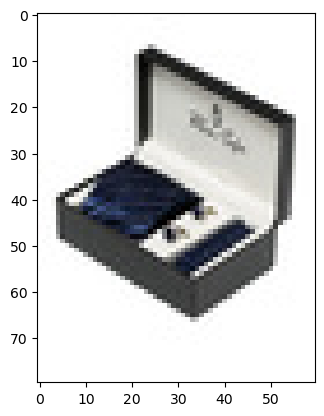

Cabarelli Men Accessory Gift Set


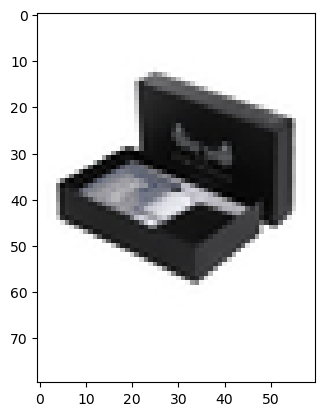

1
Red Rose Pink & Black Nightdress


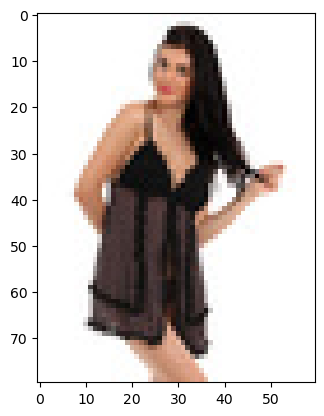

2
Nike Unisex Swoosh Black Backpack


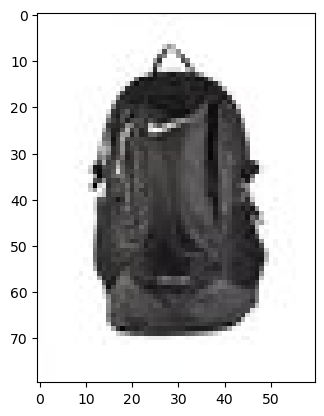

ADIDAS Unisex Chicago Bulls Red Backpack


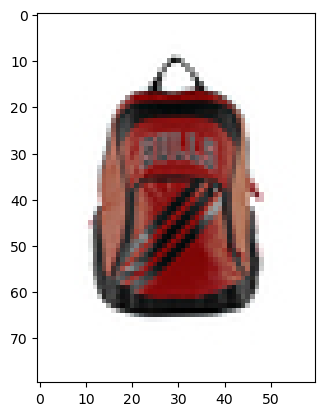

3
Royal Diadem Set of 2 Golden Bangles


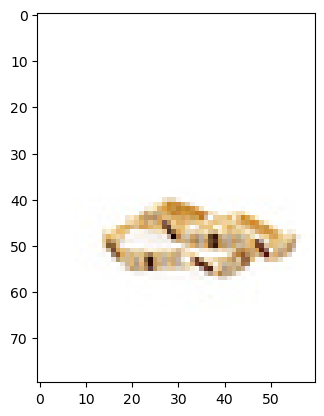

Revv Men Steel Bangle


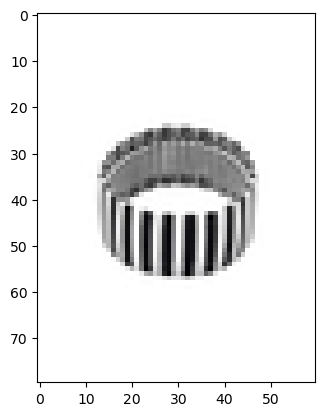

4
ADIDAS Black Bounce Unisex Basketball


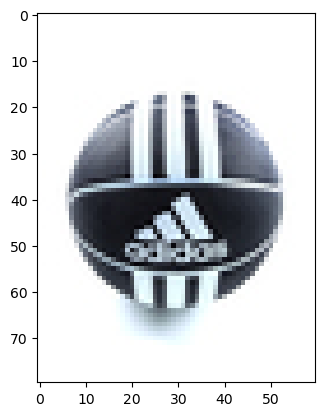

Spalding 150 SZ Brown Basketball


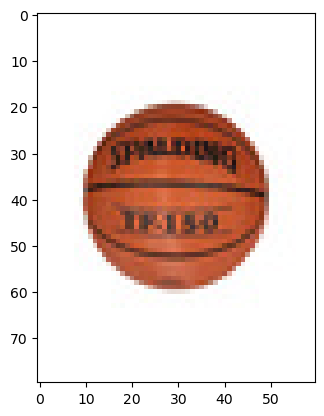

5
Red Rose Women White & Pink Polka Dot Print Bath Robe


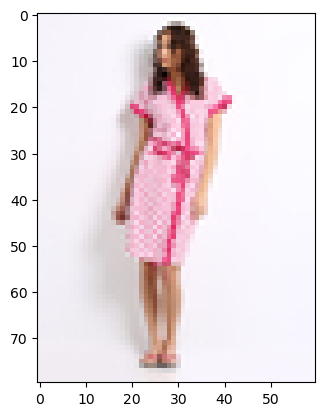

Red Rose White & Red Dot Print Bath Robe


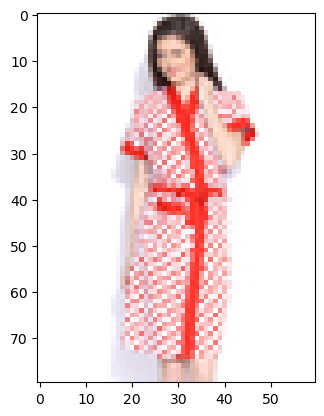

6
Colorbar Miss Reflective Body Shimmer 001


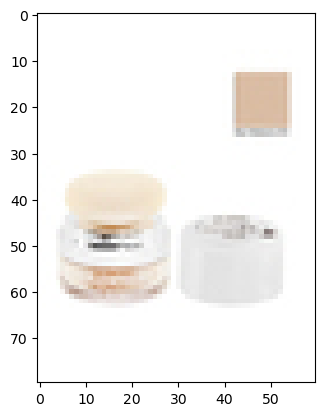

Lakme Dual Sharpener


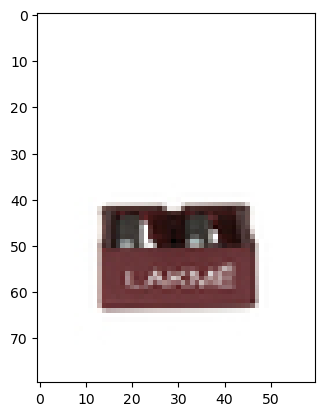

7
Fossil Women Black Huarache Weave Belt


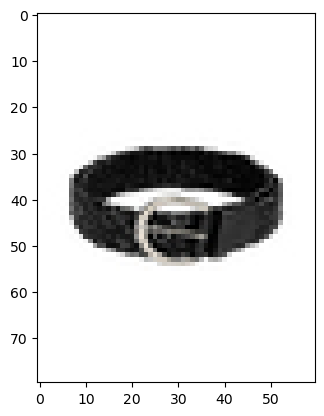

Peter England Men Formal Black Belt


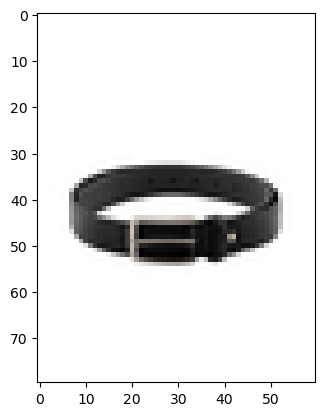

8
Scullers For Her Charcoal Blazer


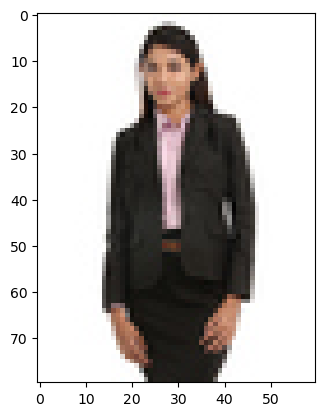

Gini and Jony Boys Printed Navy Blue Blazer


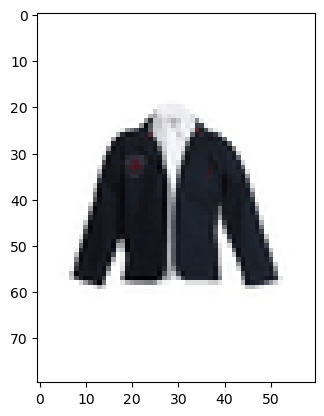

9
Lotus Herbals Almond Nourish Body Lotion with SPF 20


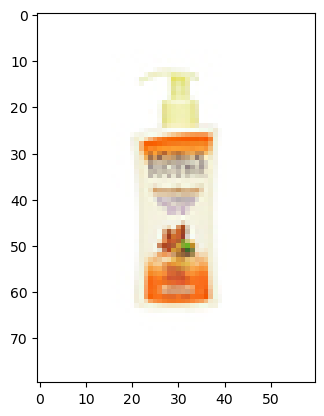

Lotus Herbals Aloe Soft Body Lotion


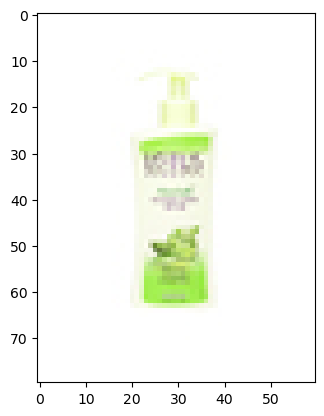

10
BOSS Men Selection Shower Gel


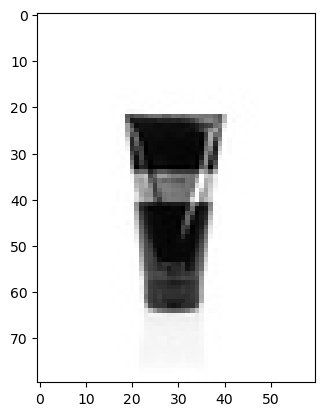

11
Madagascar 3 Infants Boys White Booties


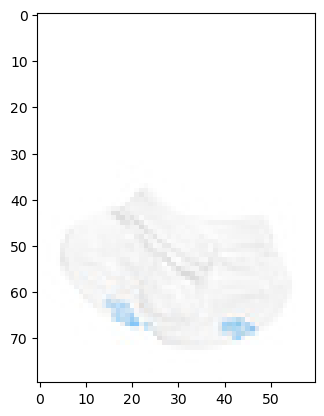

Madagascar 3 Infant Boys Yellow Booties


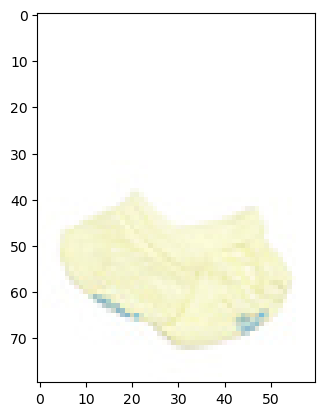

12
Probase Multicoloured Printed Boxers


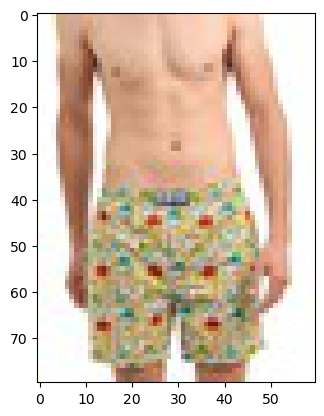

Crusoe Men Grey Boxers 1017


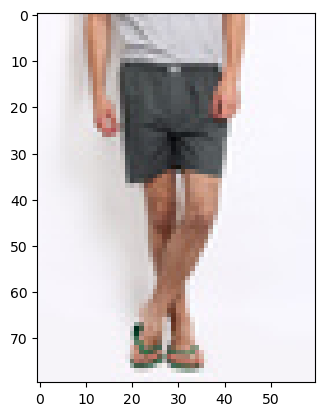

13
Bwitch Beige Full-Coverage Bra BW335


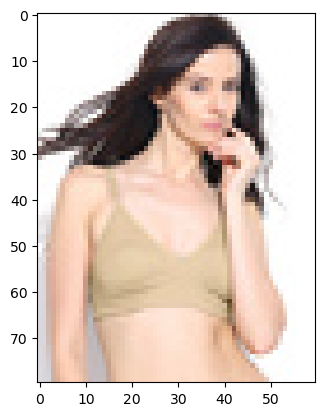

Lovable Women All Day Long Black Bra


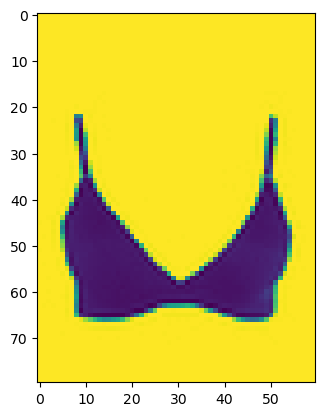

14
Pitaraa Women Bronze Beaded Bracelet


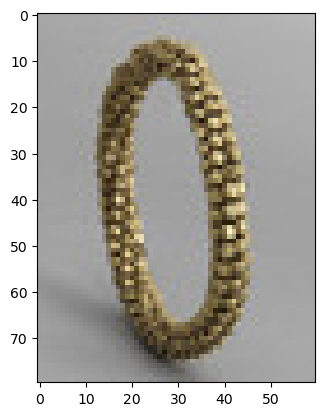

Revv Men Steel Bracelet


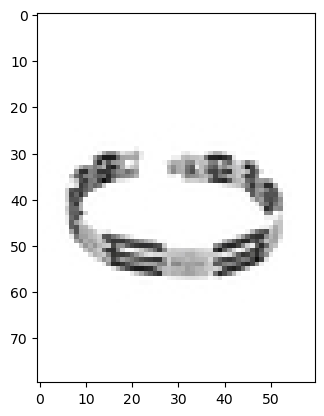

15
Levis Men Boxer Maroon Brief


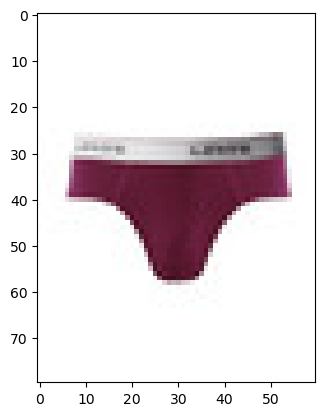

Playboy Men Blue Titanium Briefs


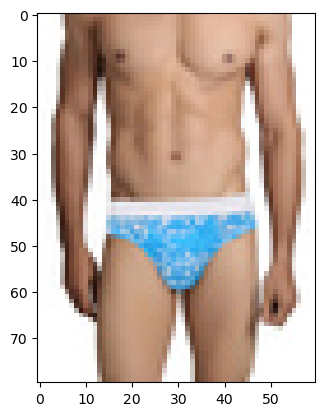

16
Red Rose Maroon Camisole


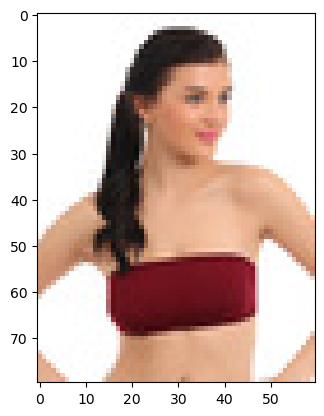

Red Rose Red Camisole


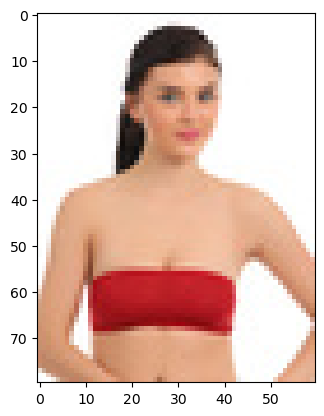

17
Gini and Jony Girls Black Capris


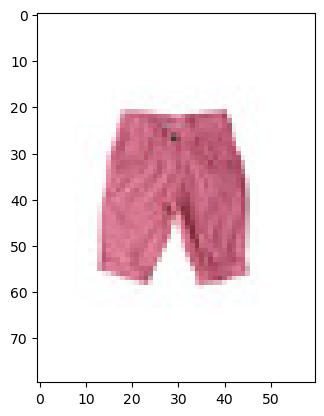

Do u speak Green Girls Olive 3/4 Pant


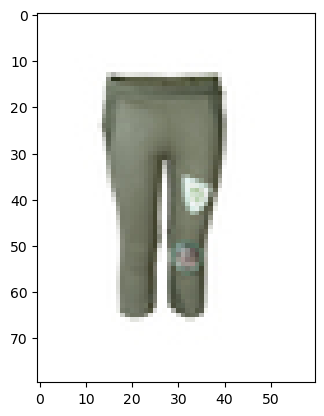

18
Manchester United Men Solid White Cap


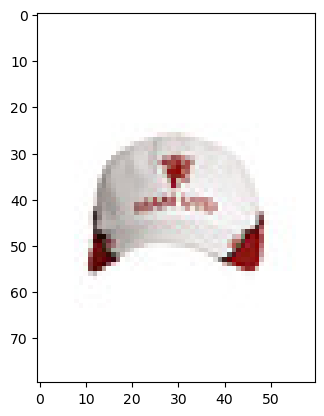

Puma Unisex White Cap


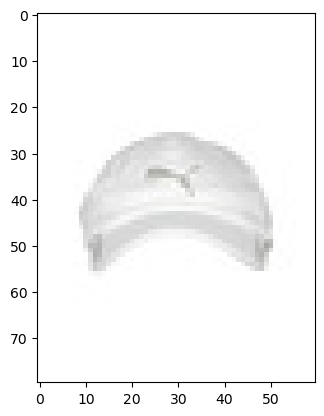

19
Puma Men Future Cat Remix SF Black Casual Shoes


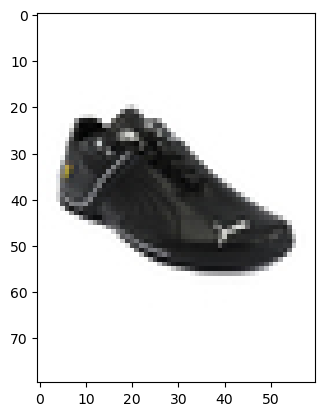

Gas Men Europa White Shoes


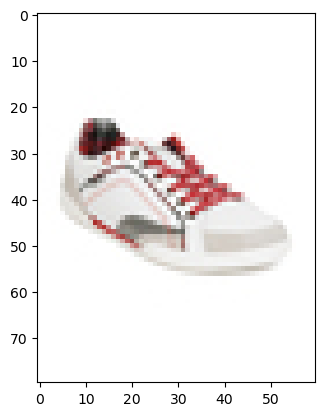

20
Fabindia Women Printed Blue & Red Churidar


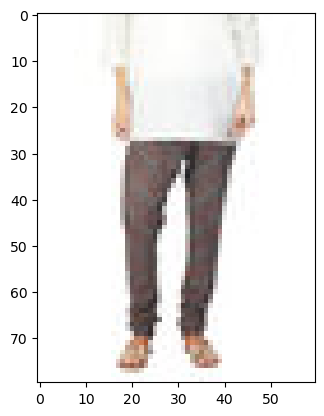

Fabindia Women Purple Churidar


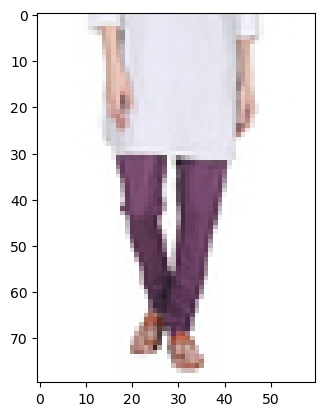

21
Jungle Book Boys Baby Blue Clothing Set


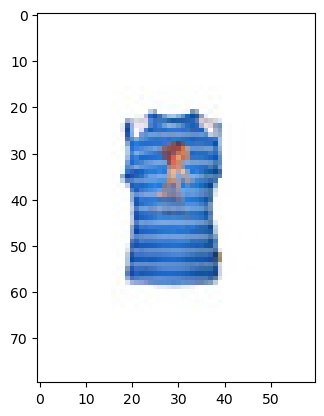

Jungle Book Boys Baby Red Clothing Set


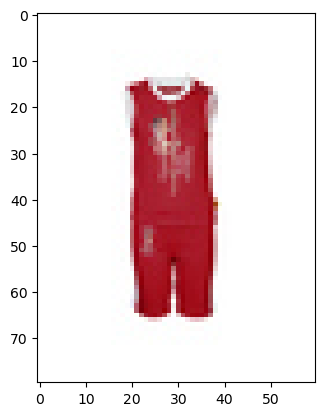

22
Spice Art Women Ribbon Embroidery Red Clutch


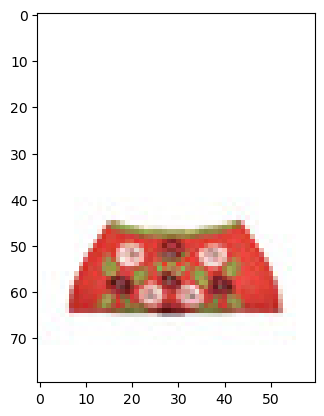

Yelloe Off White Fur Zip Clutch


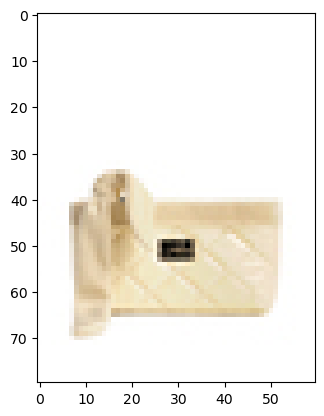

23
Lotus Herbals Natural Blend Botanical Compact 550


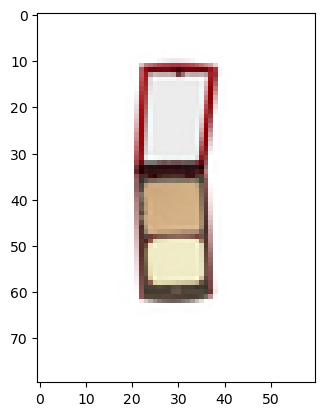

Lotus Herbals Nude Botanical Compact 560


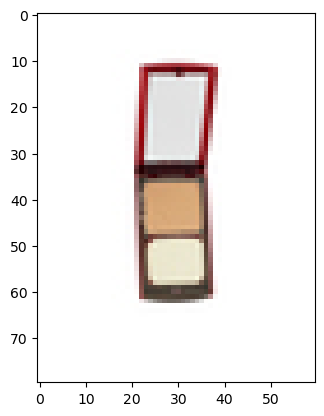

24
Revlon Photo Ready Light Medium Concealer 003


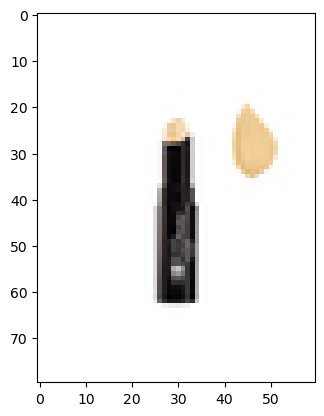

Revlon Photo Ready Medium Deep Concealer 005


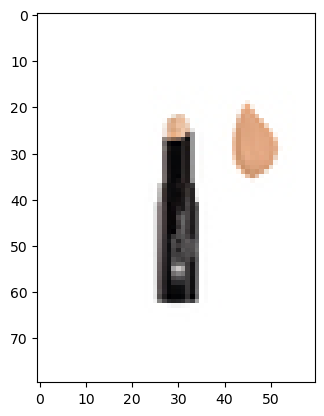

25
Hakashi Men Blue Cufflinks


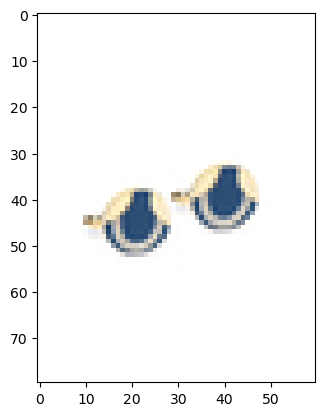

Belmonte Men Formal Steel Cufflinks


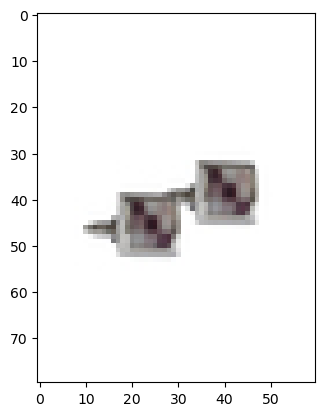

26
Swayam Unisex Yellow and Orange Cushion Covers (Set of 2)


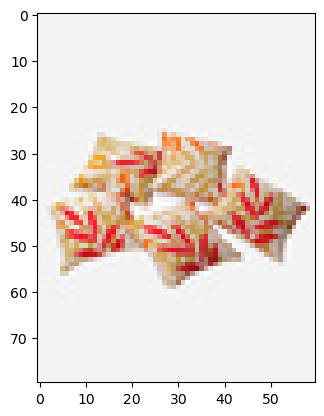

27
David Beckham Signature Men Deos


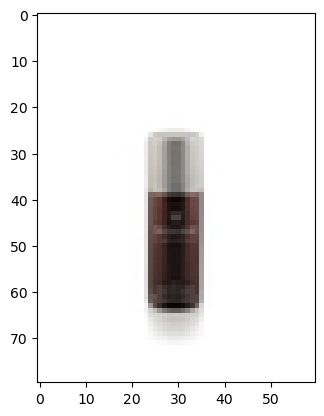

Reebok Men Pack of 2 Pirates of the Caribbean Deos


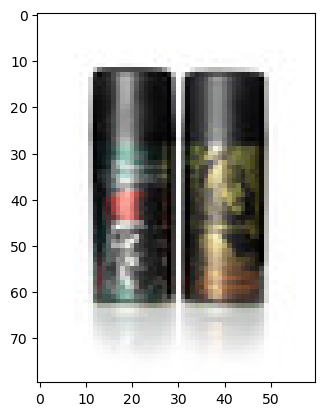

28
Arrow Woman Women Blue Dress


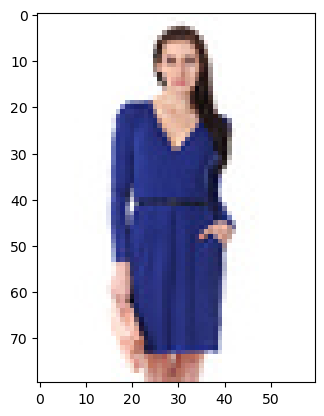

Gini and Jony Girl's Vanya White Polka Dot Kidswear


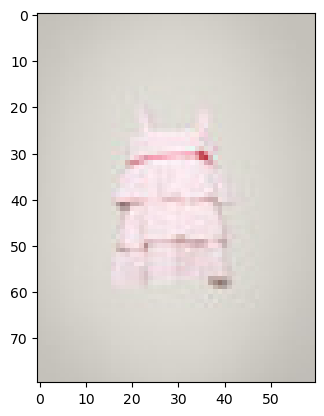

29
Wildcraft Unisex Red Duffle Bag


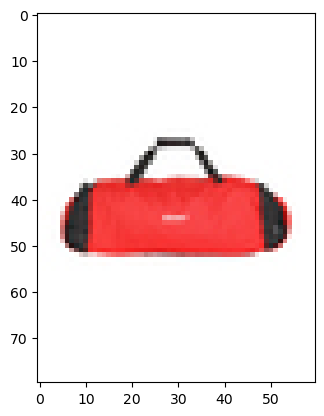

Wildcraft Unisex Black & Grey Duffel Bag


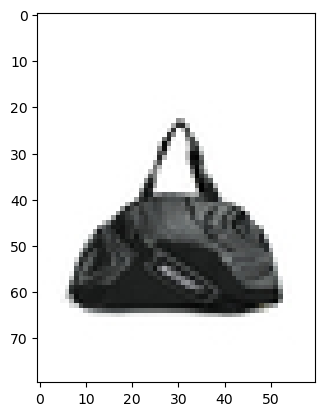

30
Aurelia Women Voile Orange Dupatta


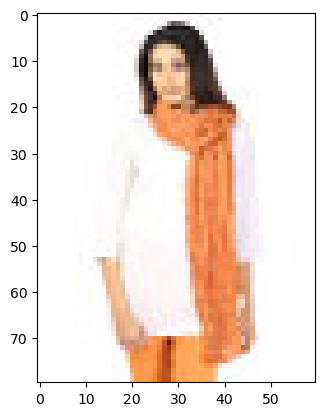

Fabindia Women Multi Coloured Chanderi Dupatta


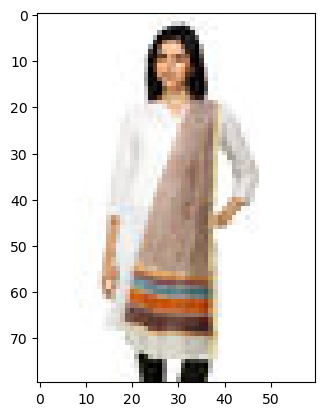

31
Fabindia Women Anusuya Silver Earrings


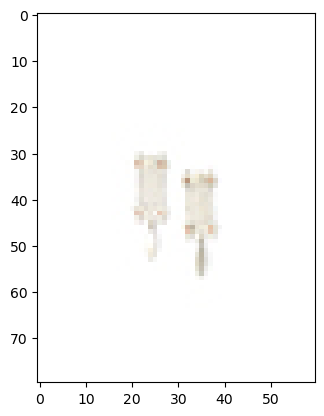

Estelle Women Gold Earrings


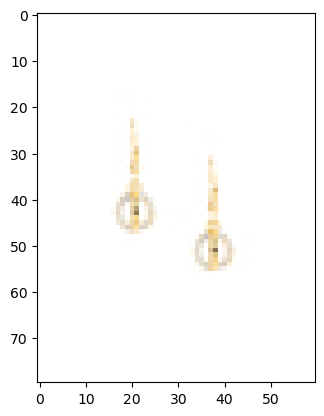

32
Olay Women Total Effects Anti-Ageing Eye Cream


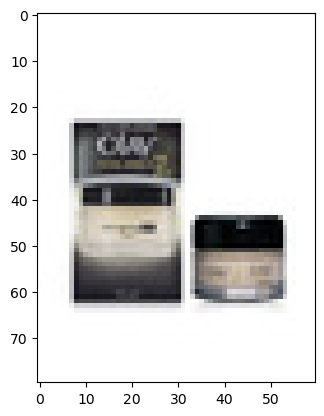

Revlon Touch & Glow Advanced Fairness Under Eye Repair Cream


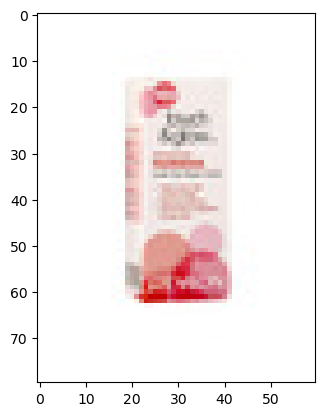

33
Streetwear Groovy Baby Eye Shadow


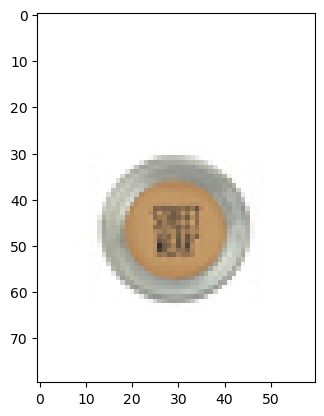

Streetwear Bombshell Eye Shadow


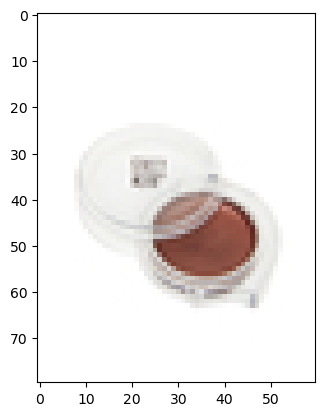

34
Lotus Herbals Whiteglow Yogurt Skin Whitening & Brightening Face Masque 80 g


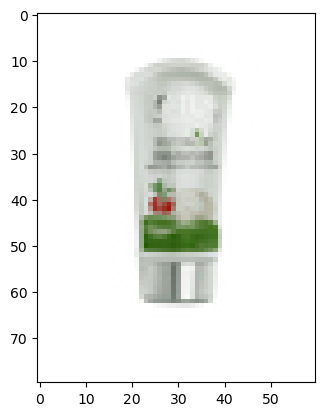

Pond's Gold Radiance Precious Youth Serum


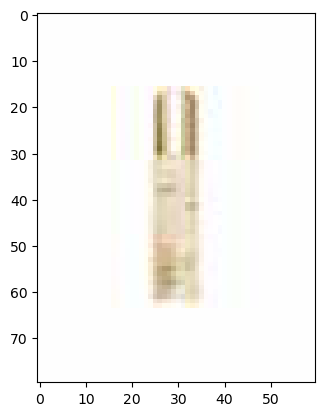

35
Lotus Herbals Apriscrub Fresh Apricot Scrub 60g


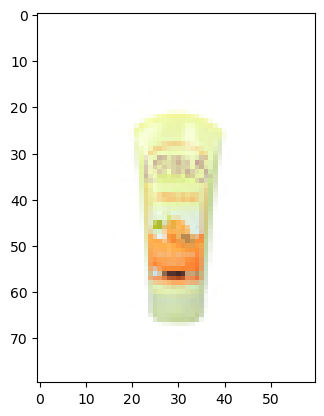

Biotique Women Bio Papaya Revitalizing Scrub


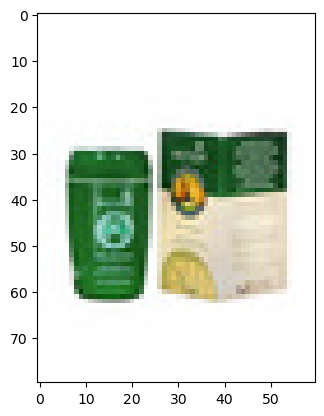

36
Olay Women White Radiance Intensive Brightening Serum


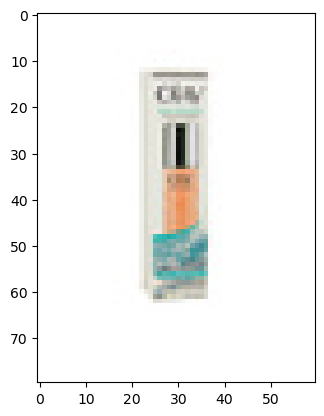

Biotique Bio Chlorophyll Oil-Free Anti-Acne Gel


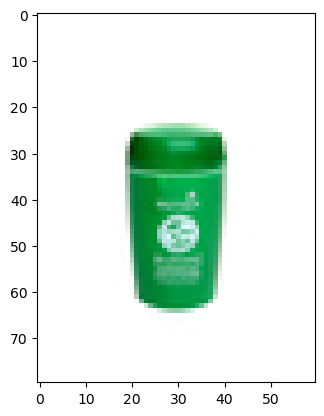

37
Lotus Herbals Neem & Clove Purifying Face Wash


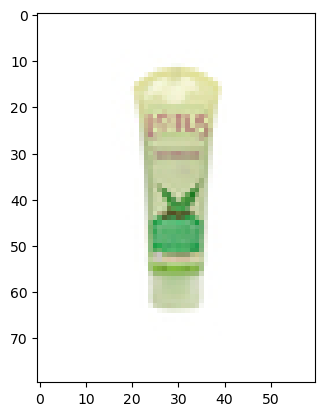

Lotus Herbals Jojobawash Face Wash


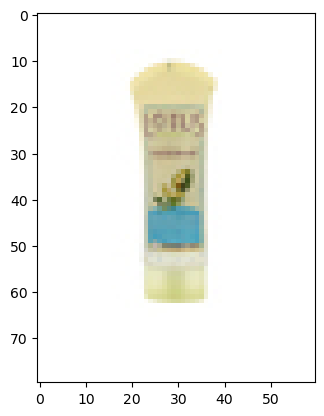

38
Carlton London Women Black & Gold Toned Flats


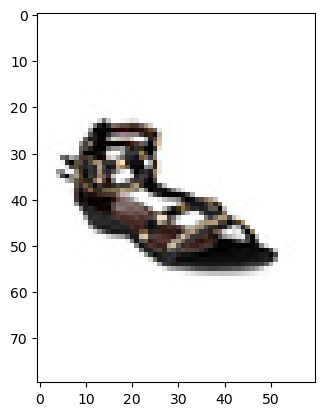

Catwalk Women Leather Brown Flats


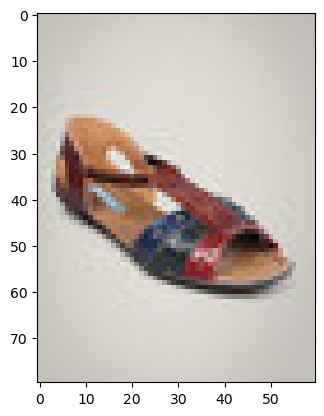

39
Fila Men Cush Flex Black Slippers


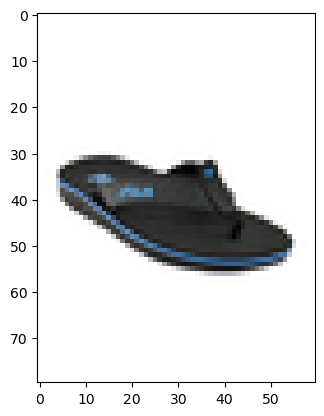

Ben 10 Boys Navy Blue Slippers


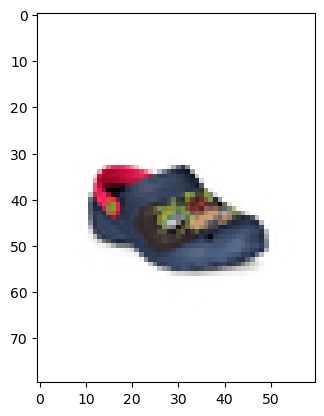

40
Puma Unisex Liga XL Football


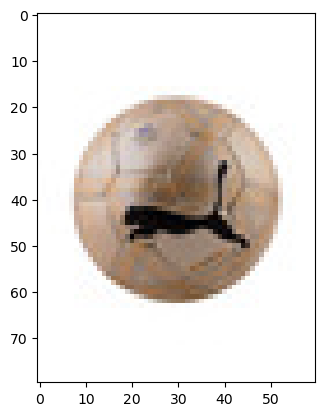

ADIDAS Red Bull Trophy Soccer Unisex Football


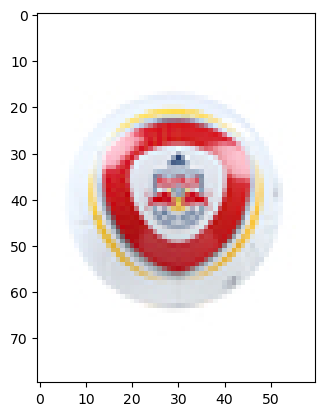

41
Buckaroo Men Flores Black Formal Shoes


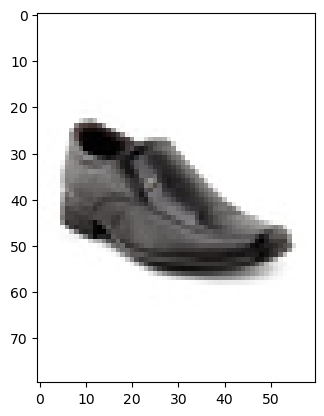

Clarks Men Hang Work Leather Black Formal Shoes


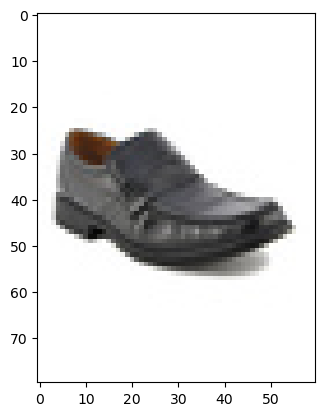

42
Lakme Nine to Five Flawless Makeup Shell Foundation


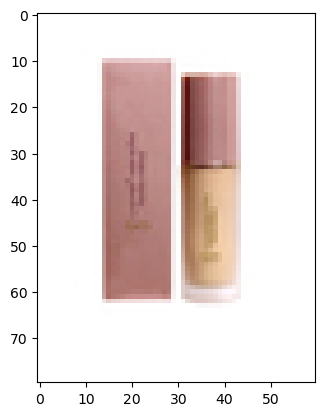

Lakme 9to5 Flawless Makeup Marble Foundation


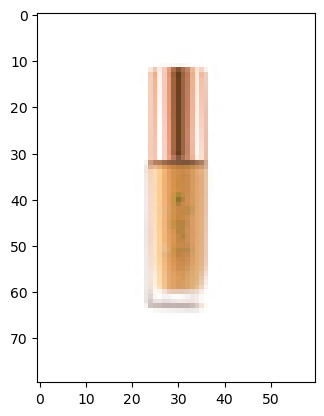

43
Nike Fragrances Women Sensual Touch Perfume and Deo Set


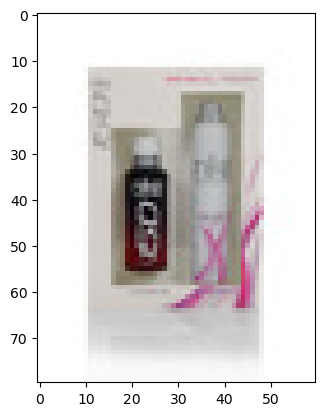

Reebok Men Reeplay Perfume & Deodorant Set


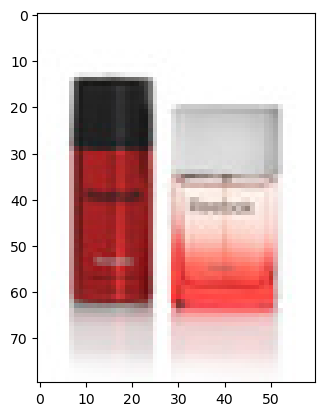

44
Q&Q Men Black Digital Watch


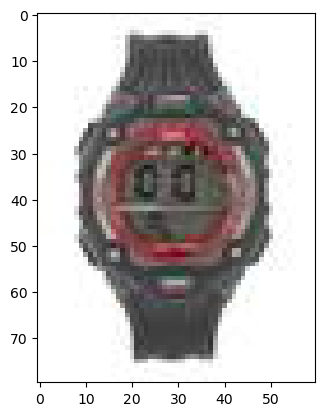

Q&Q Men White Dial Watch


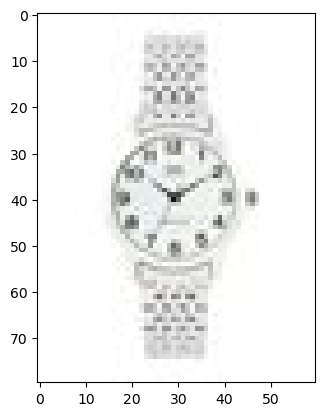

45
United Colors of Benetton Men Solid Black Gloves


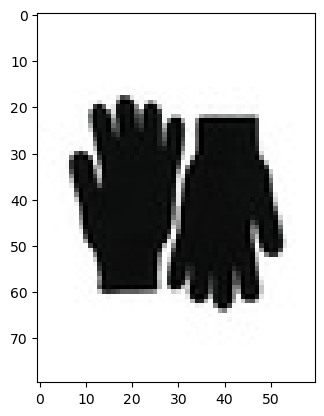

Madagascar 3 Infants Girl Pink Mittens


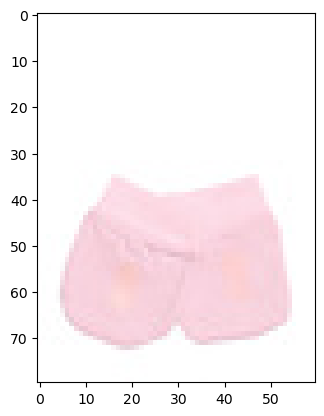

46
ToniQ Women Pink Hair Accessories


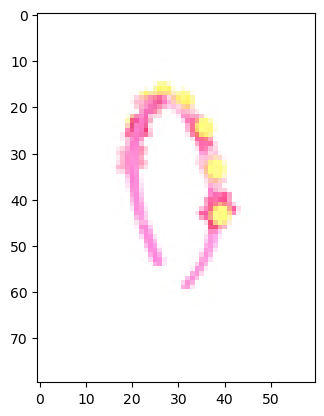

47
Revlon Colorsilk Luminista Golden Brown Hair Colour 120


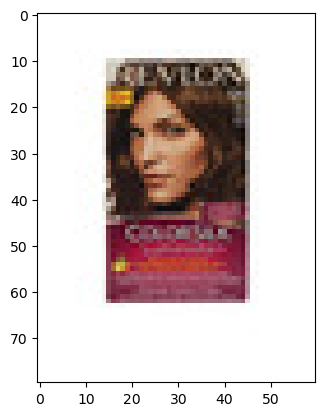

Revlon Top Speed 60 Natural Brown Ammonia-Free Hair Colour


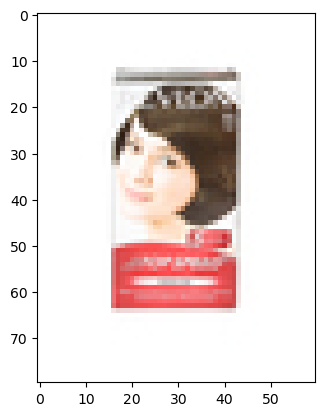

48
Murcia Women Blue Handbag


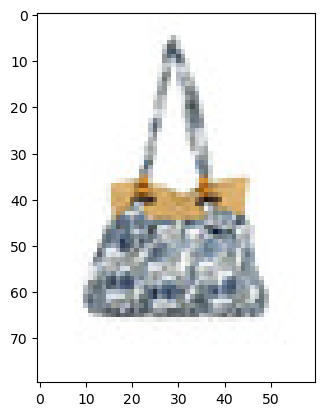

Baggit Women Brown Handbag


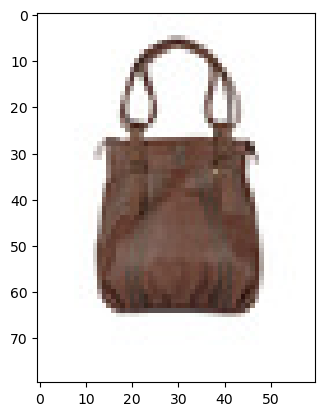

49
Timberland Unisex Casual Black Skull Caps


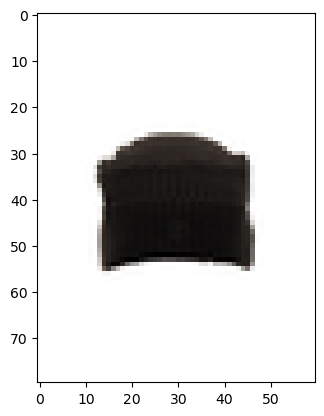

ADIDAS Unisex Beanie Black Skull Caps


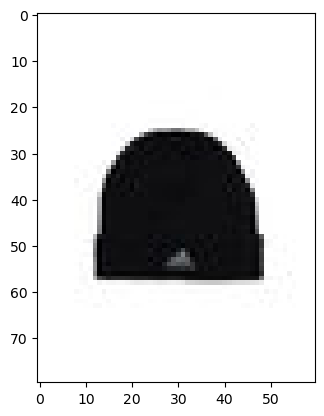

50
Puma Unisex Cat White Headband


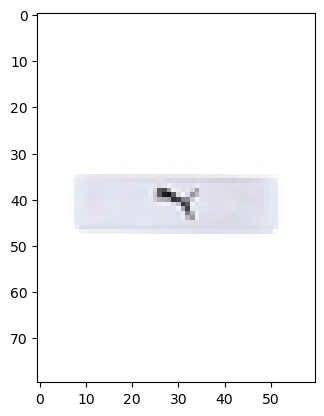

Puma Unisex Cat Black Headband


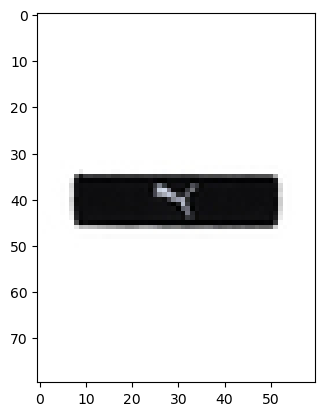

51
Rocia Women Black Flats


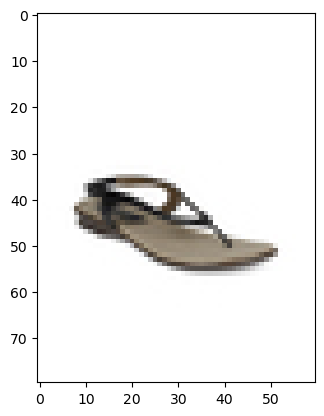

Catwalk Women Leather Flats


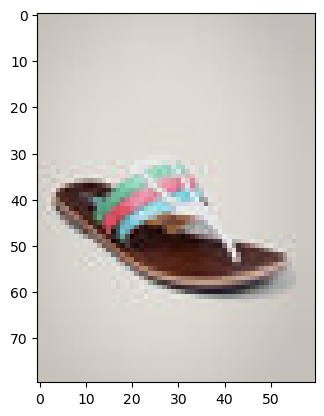

52
Colorbar Glamour Radiant Glow 001


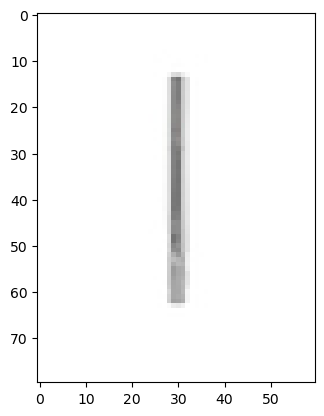

Streetwear True Color Claret Tint Blusher


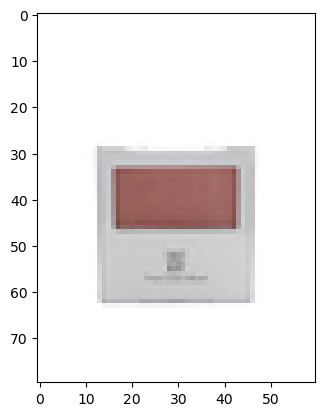

53
Levis Men Comfort Style Grey Innerwear Vest


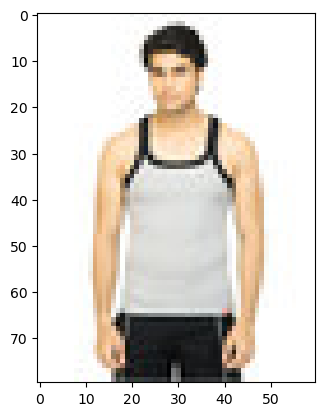

Levis Men White Innerwear Vest


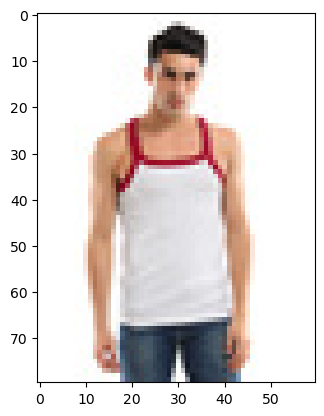

54
Senorita Women Blue Flats


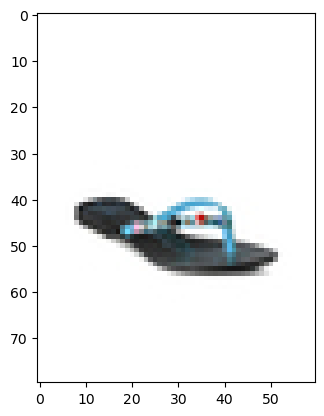

55
Forever New Women Stone Cream Jacket


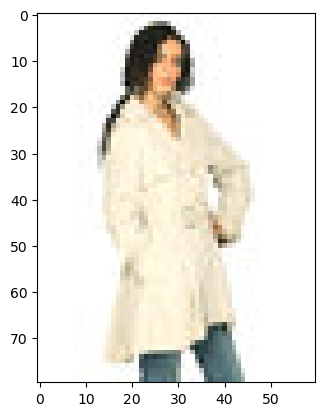

Forever New Women Indigo Wash Blue Jacket


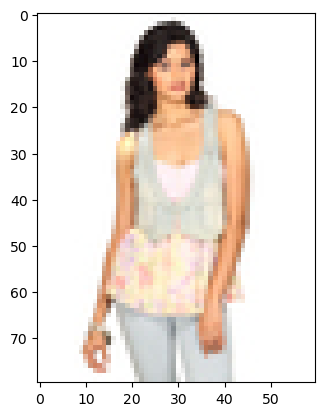

56
Peter England Men Party Blue Jeans


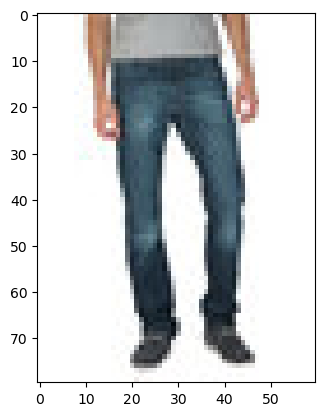

Jealous 21 Women Black Jeans


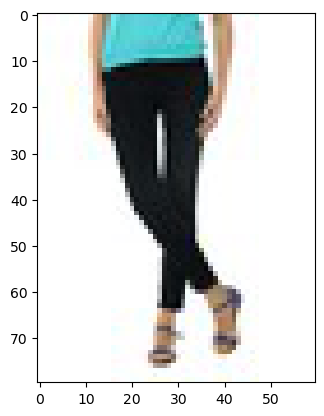

57
Wrangler Women Blue Jeggings


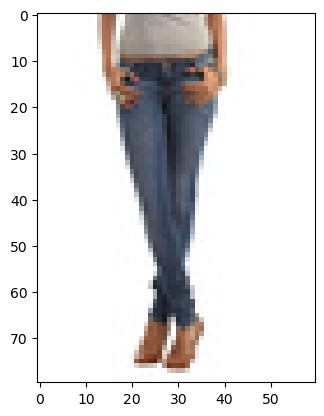

Kraus Jeans Women Blue Jeggings


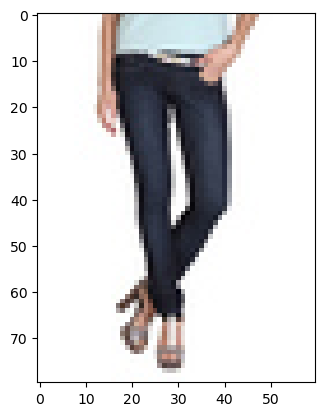

58
Estelle Women Earrings & Pendant Set


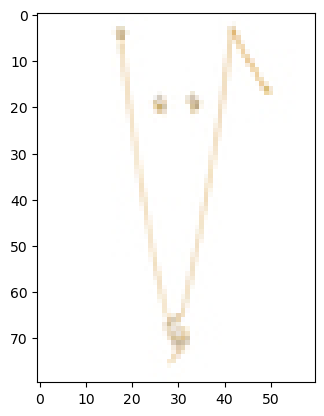

Estelle Women Gold Earring & Pendant Set


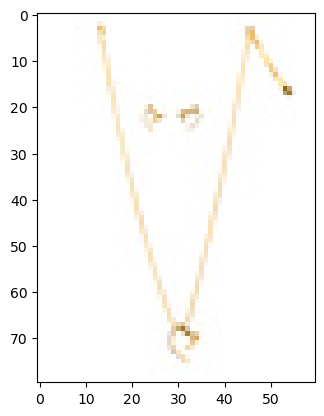

59
Arrow Woman Olive Jumpsuit


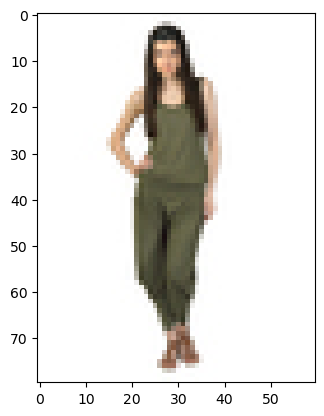

French Connection Women Blue Jumpsuit


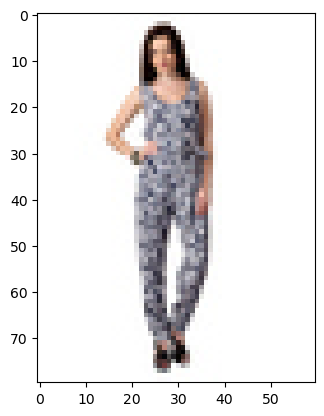

60
Peperone Women Beige Handbag


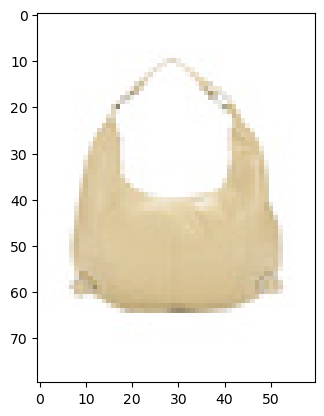

Revlon Grow Luscious Graphite Eye Liner


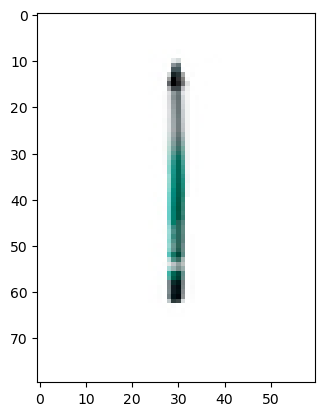

61
Wildcraft Unisex Black & Grey Carabiner Key Chain


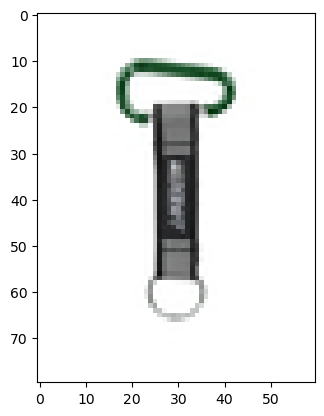

American Tourister Unisex Black Key Case


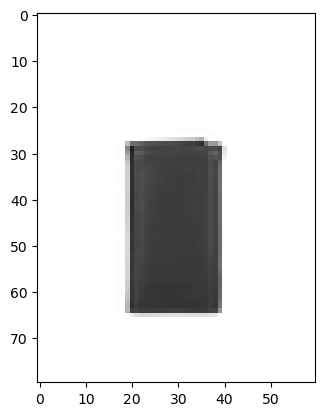

62
Aneri Women Black & Maroon Salwar Suit


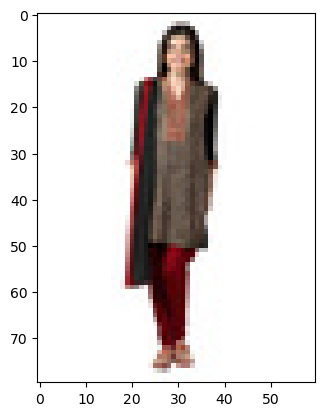

Aneri Women Purple Salwar Suit


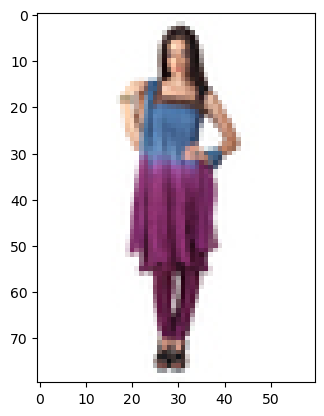

63
Diva Women Embroided Green Kurta


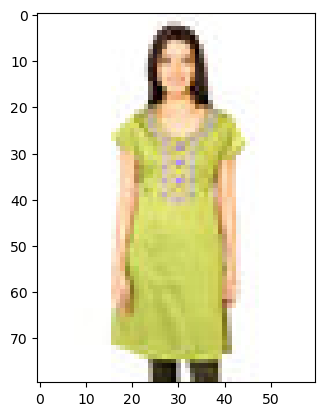

W Women Printed Beige Kurta


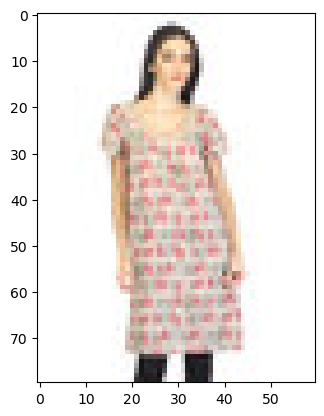

64
Aneri Women Multi Coloured Kurti


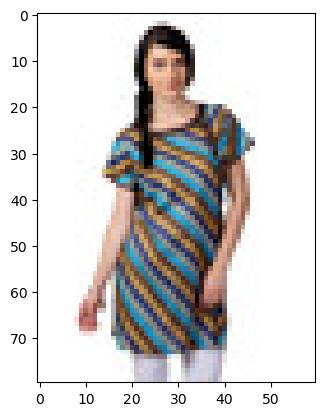

Mumbai Slang Women Pink & Black Kurti


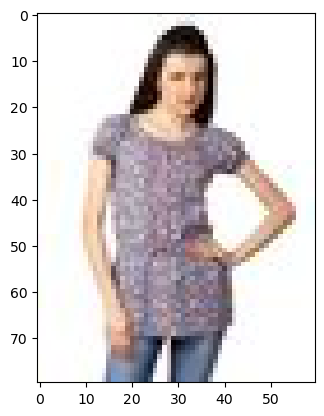

65
Peter England Unisex Orange Sleeve Bag


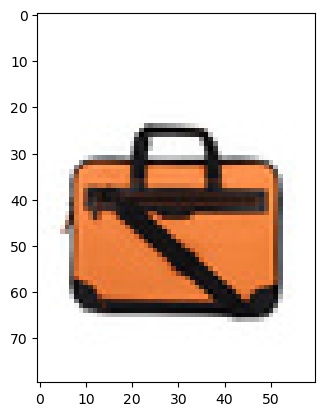

Peter England Unisex Brown Laptop Bag


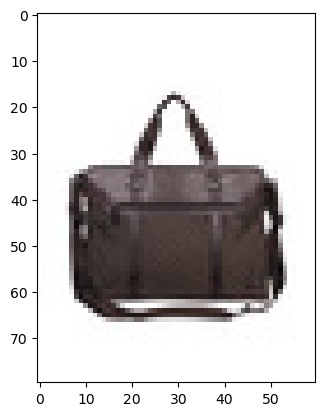

66
Aurelia Women Solid Purple Leggings


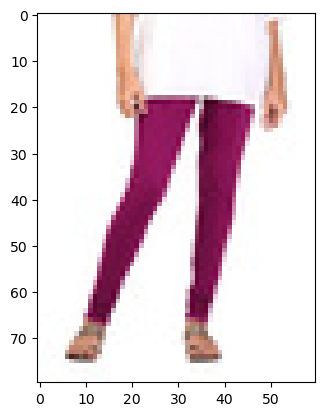

Arrow Woman Brown Jeggings


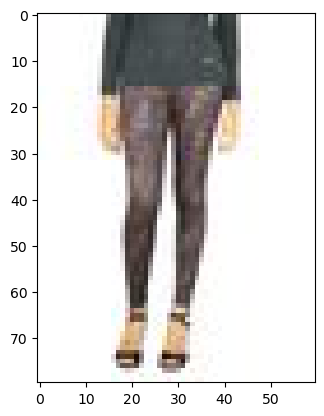

67
Fabindia Girls Printed Pink Lehenga Choli


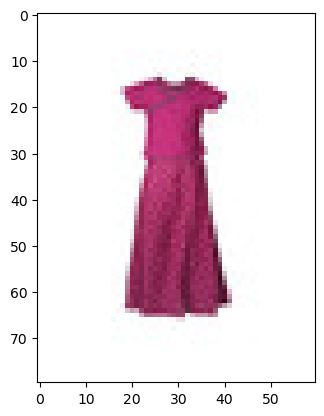

Fabindia Girls Printed Blue Lehenga Choli


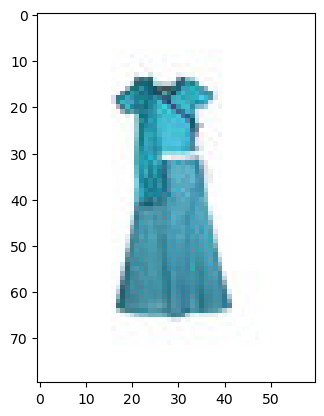

68
Lakme Lip Love Hottie Lip Conditioner


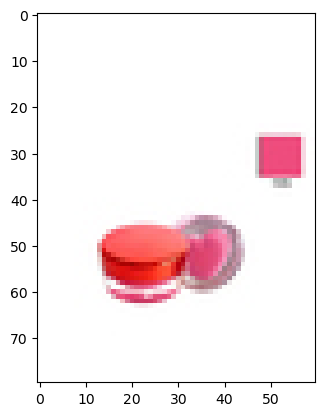

Lotus Herbals Fruity Fusion Lip Balm


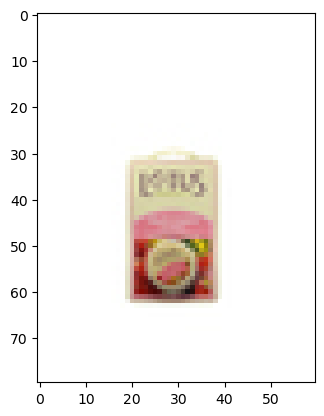

69
Revlon Gold Dust Poussiere Doree Colorburst Lip Gloss 024


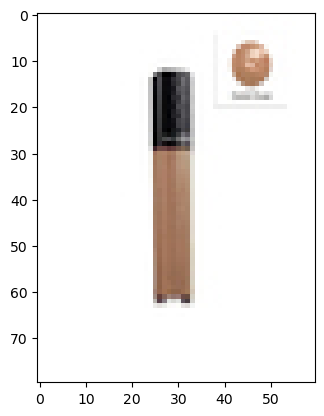

Lakme Sheer Satin Lip Gloss 51


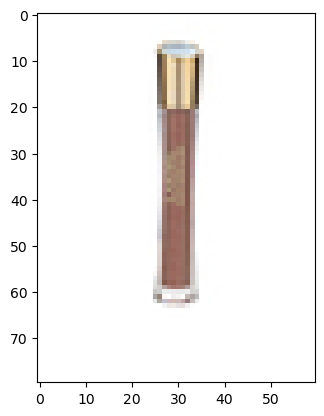

70
Deborah 24 Ore Lip Liner 220


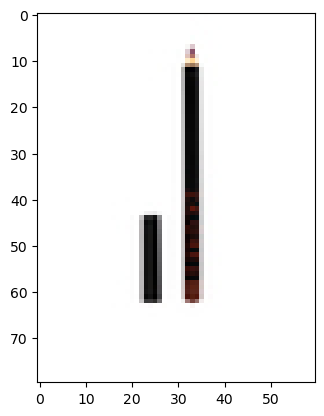

Colorbar Plum Lip Liner/Crayon 004


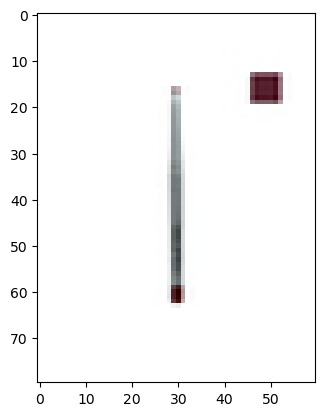

71
Deborah Truy Pink Volume Lip Plumper 01


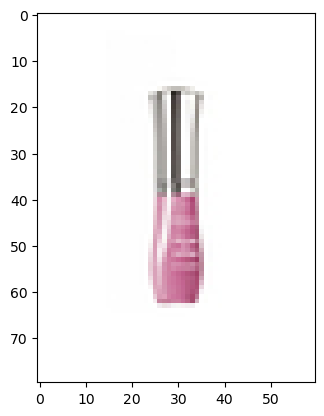

Deborah Burgundy Volume Lip Plumper 03


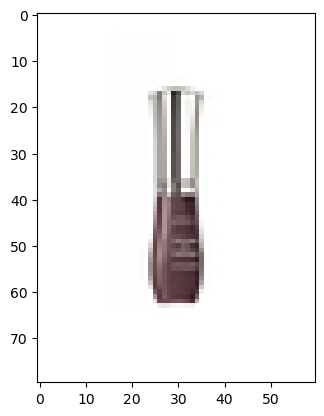

72
Colorbar Soft Touch Show Stopper Copper Lipstick 037


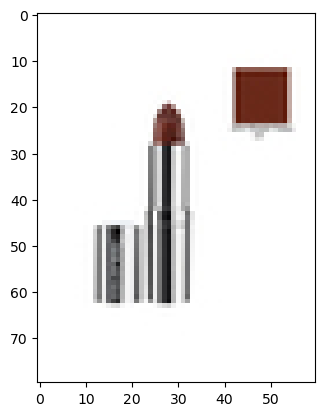

Colorbar Soft Touch Mousse Lipstick 025


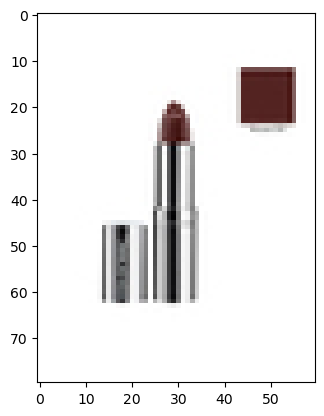

73
Jockey Women Blue Lounge Pants


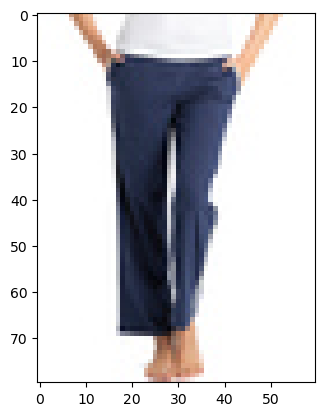

Jockey Women Black Lounge Pants


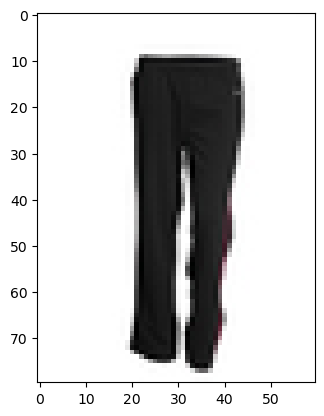

74
Hanes Men Knitted Red Shorts


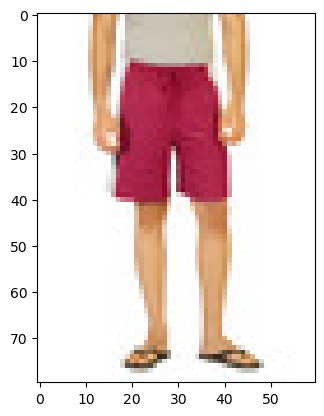

Jockey Women Purple Lounge Shorts 1308


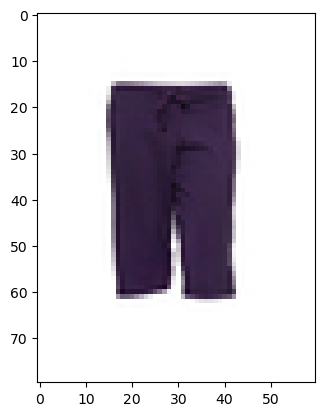

75
Inaya Women Lounge Top


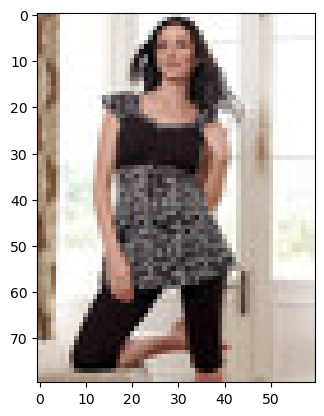

Inaya Women Black Lounge Top


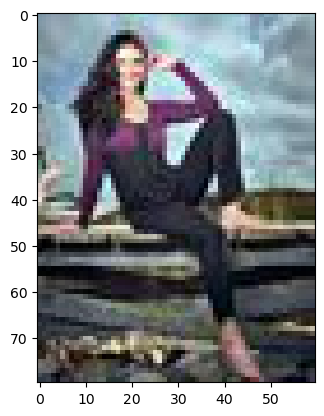

76
Streetwear Makeup Remover


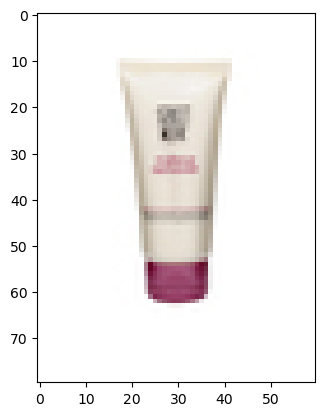

Biotique Bio Almond Oil Soothing Face & Eye Makeup Cleanser


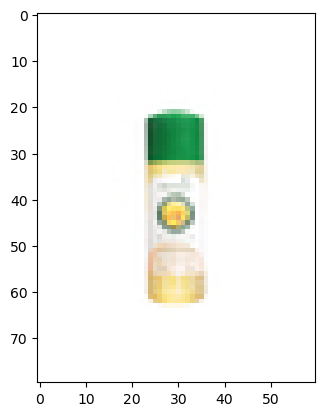

77
Revlon Water Tight Black Mascara


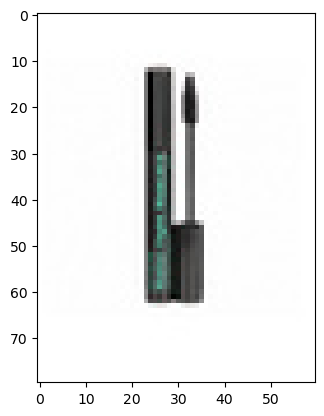

Revlon Lash Fantasy Blackest Black Mascara And Primer


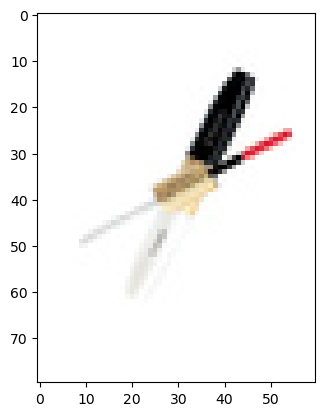

78
Lotus Herbals Tea Tree Clarifying Face Pack


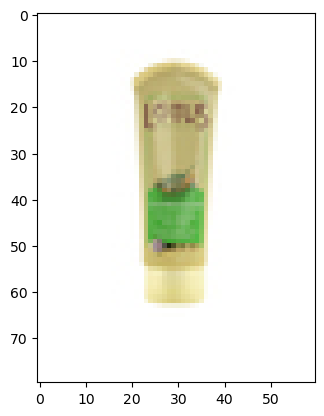

Biotique Bio Pistachio Face Pack


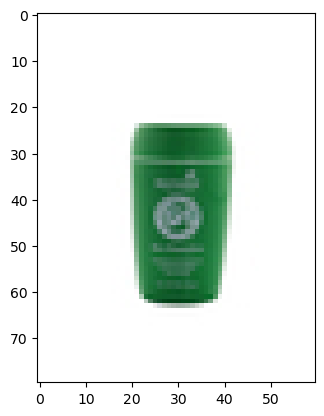

79
Baldessarini Men Strictly Private 90 ml After Shave Lotion


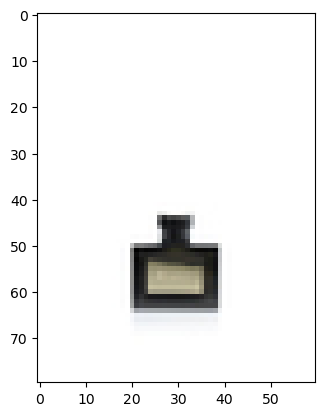

80
Wildcraft Unisex Grey Printed Messenger Bag


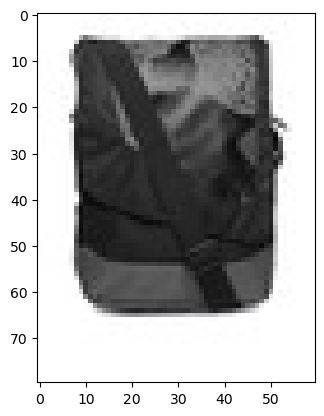

Wildcraft Unisex Black & Red Messenger Bag


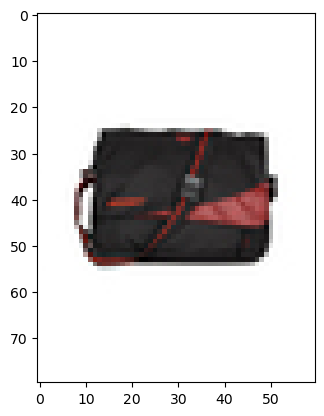

81
Baggit Women Green Mobile Pouch


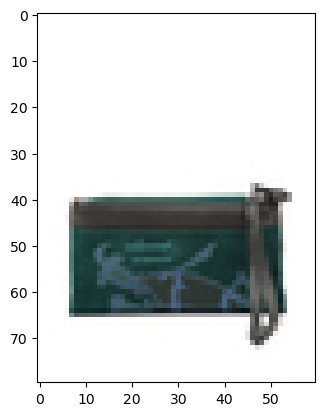

Baggit Women Purple Phulrani Brush Mobile Pouch


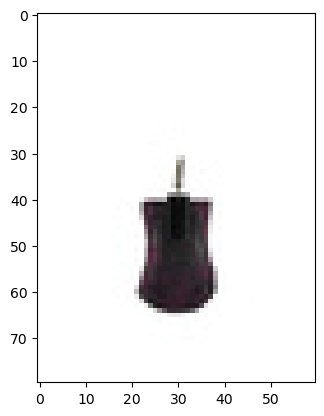

82
United Colors Of Benetton Women Yellow Muffler


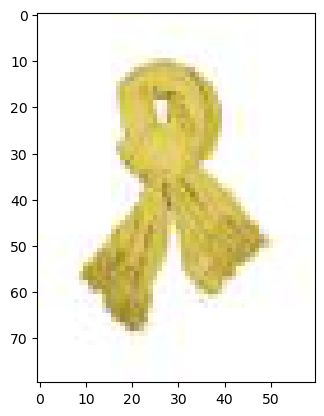

United Colors Of Benetton Women Grey Muffler


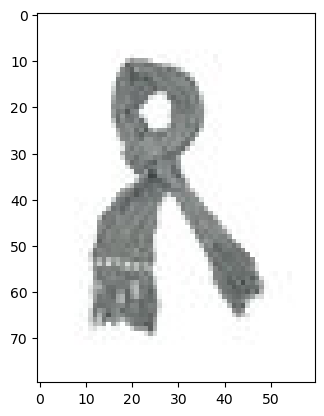

83
Colorbar Acetone Free Nail Enamel Remover


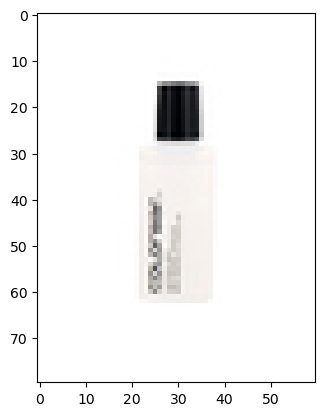

Revlon Extra Fast Nail Polish Remover


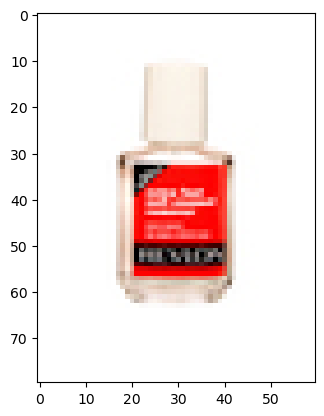

84
Streetwear Ash Nail Polish # 31


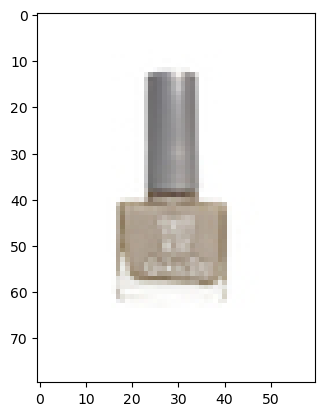

Streetwear Grape Shimmer Nail Polish 41


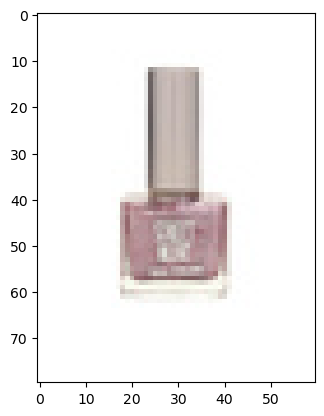

85
Lencia Grey Swarovski Pearl Necklace


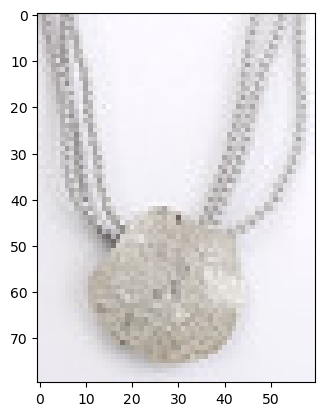

Lencia White Swarovski Pearl Necklace


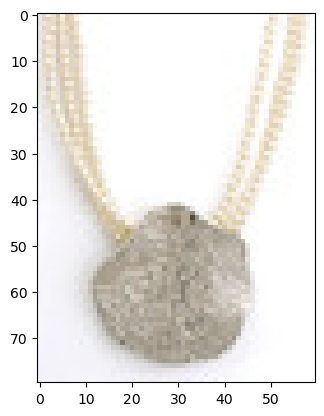

86
Fabindia Men Brown Silk Sleeveless Jacket


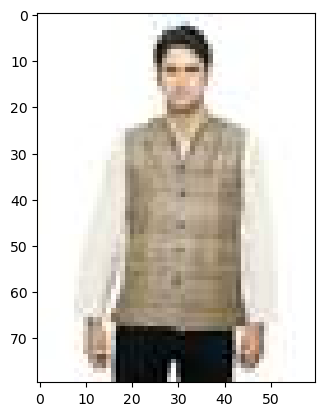

Fabindia Men Brown Silk Sleeveless Jacket


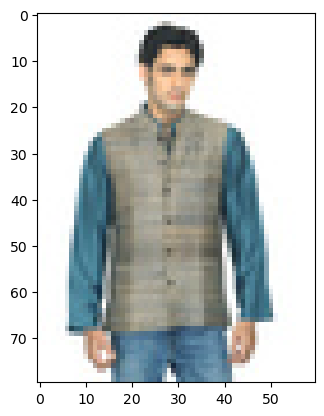

87
SDL by Sweet Dreams Women Green Printed Night Suit S11-3124


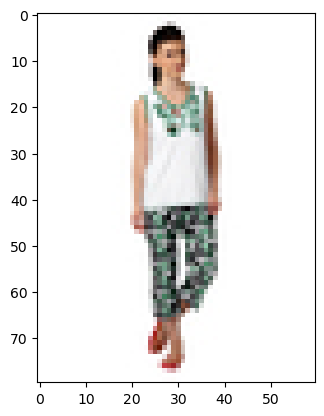

SDL by Sweet Dreams Women Pink & Black Printed Night Suit S11-3134


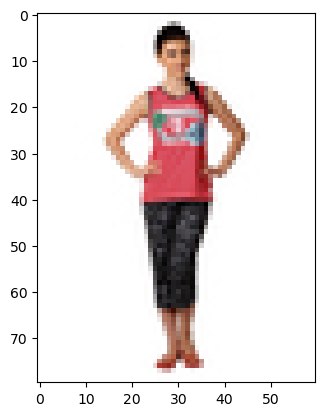

88
Enamor Women Lavender Nightdress


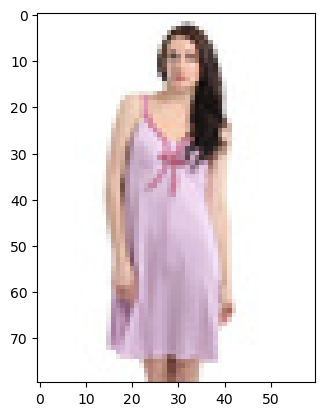

Red Rose White & Green Nightdress


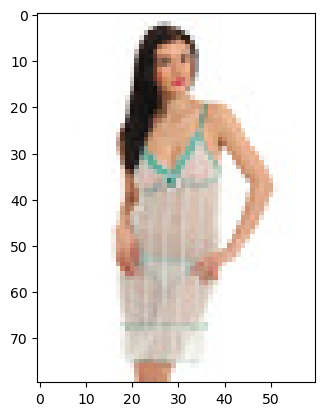

89
Fabindia Women Printed White & Blue Patiala


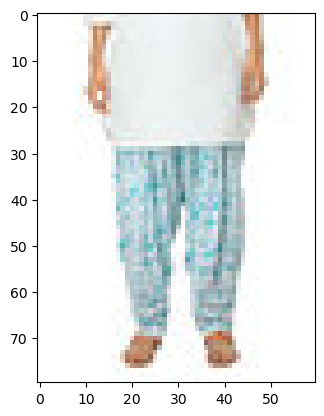

Fabindia Women Printed White & Blue Patiala


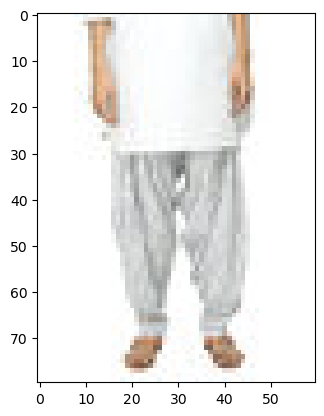

90
Lucera Women Silver Pendant


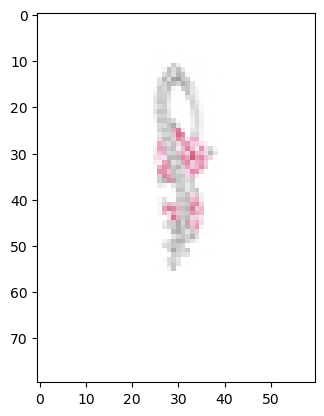

Lucera Women Silver Pendant


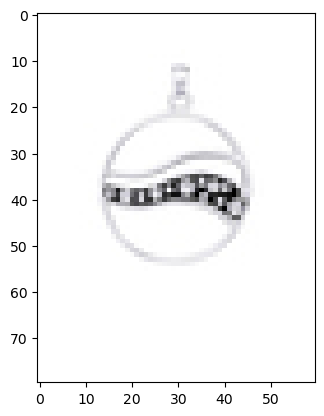

91
Police Women Passion Perfume


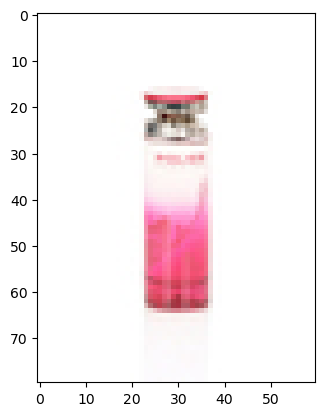

DKNY Women Red Delicious Perfume


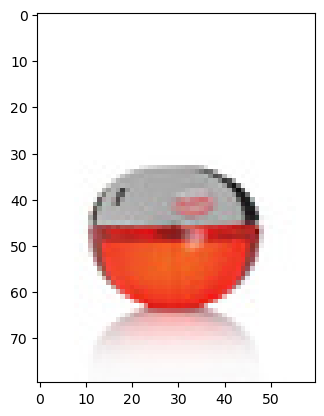

92
Just Natural Unisex Charcoal Rain Jacket


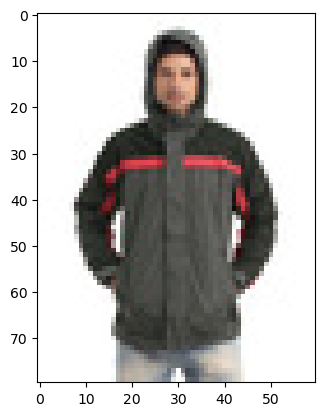

Just Natural Unisex Navy Blue Rain Jacket


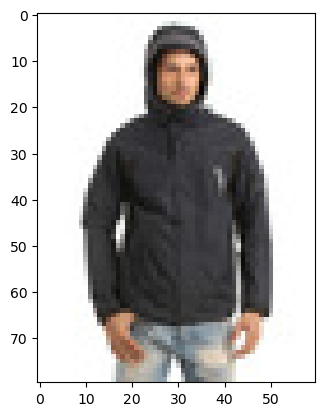

93
Wildcraft Men Black Rain Trousers


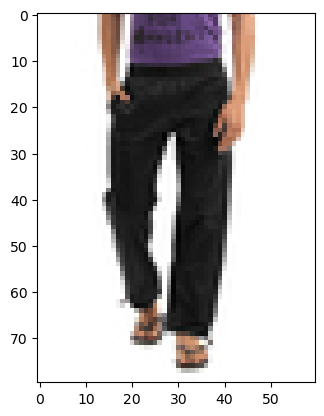

Wildcraft Men Navy Blue Rain Trousers


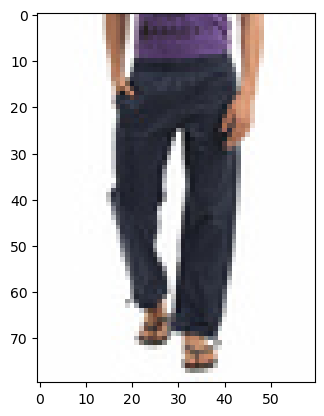

94
Lucera Women Silver Ring


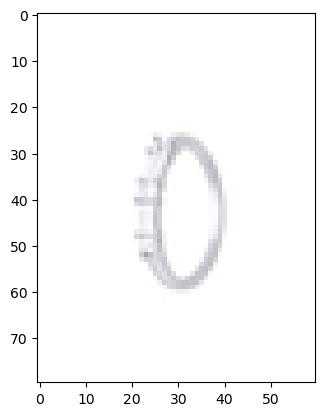

Lucera Women Silver Ring


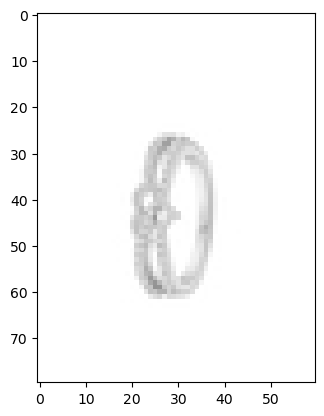

95
Enamor Women Maroon Robe


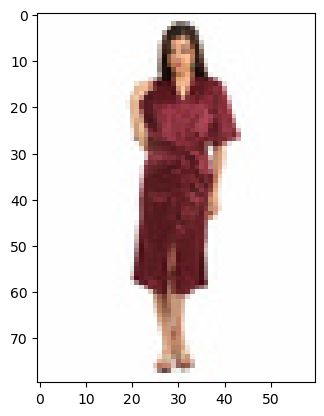

Amante Blue Robe


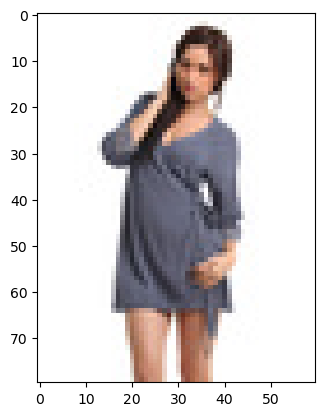

96
Madagascar3 Infant Boys White Snapsuit Romper


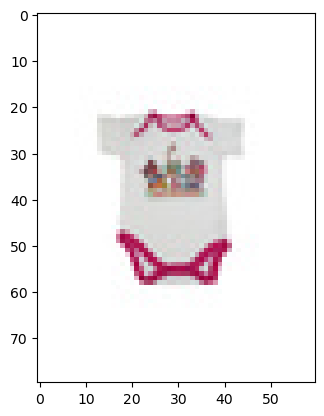

Madagascar3 Infant Boys Light Green Snapsuit Romper


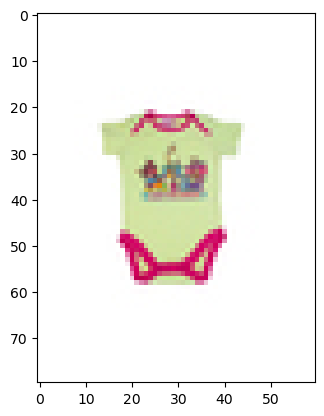

97
Wildcraft Unisex Blue & Grey Rucksack


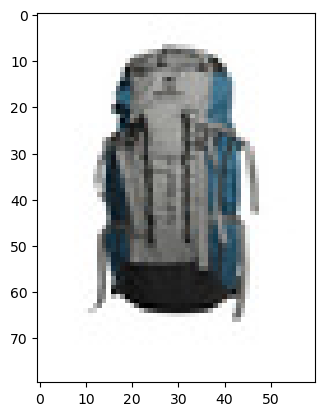

Wildcraft Unisex Yellow & Grey Rucksack


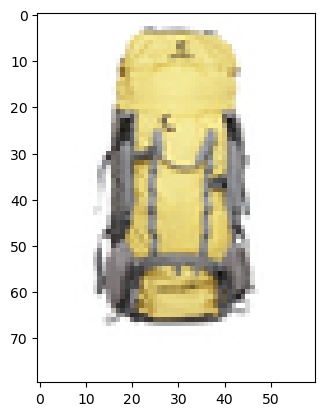

98
Shree Women Green & Purple Jodhpuri Salwar


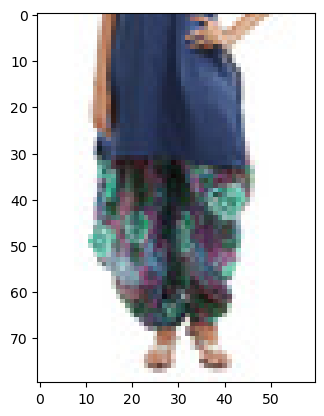

Shree Women Maroon Jodhpuri Salwar


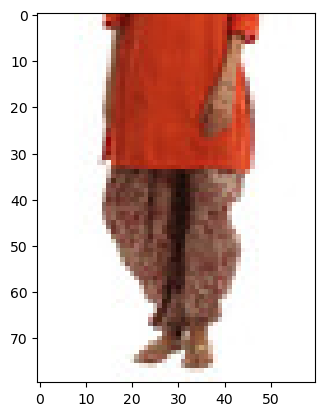

99
Vishudh Women Red & White Salwar and Dupatta


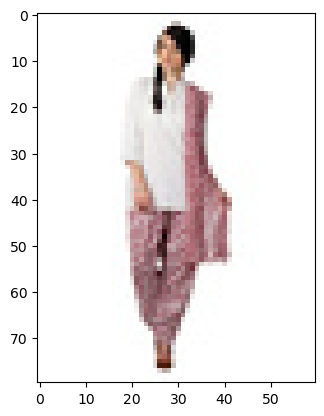

Vishudh Women Printed Cream Salwar and Dupatta


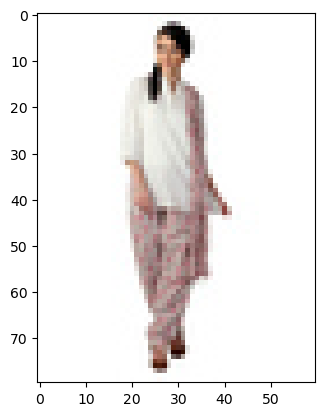

100
ADIDAS Men Spry M Black Sandals


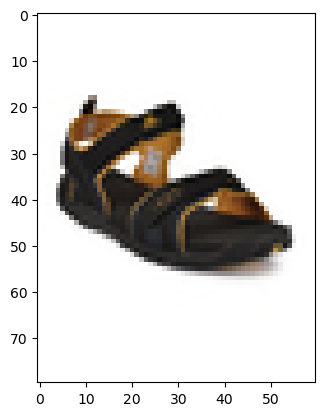

Crocs Dora Boots Pink Sandals


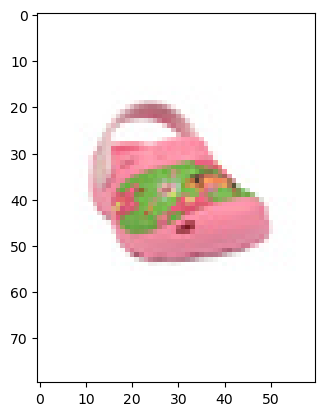

101
FNF Pink & Grey Wedding Collection Sari


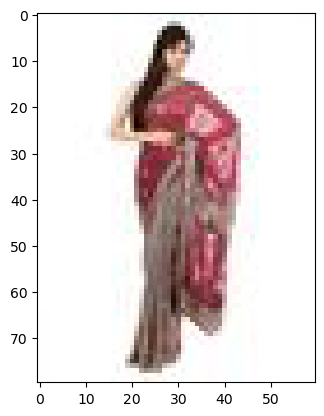

FNF Green Wedding Collection Sari


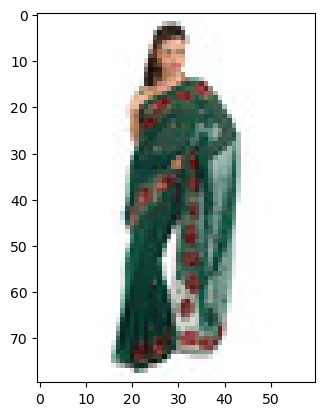

102
Femella Women Brown Scarf


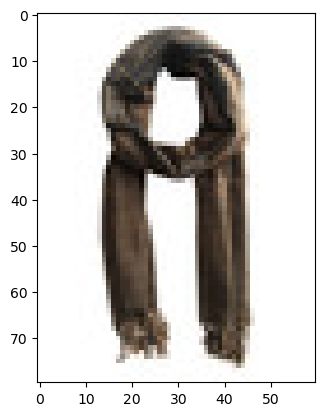

Femella Women Yellow & Blue Scarf


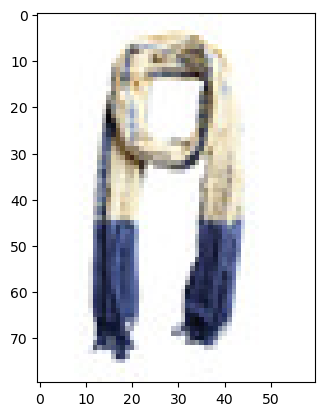

103
Avirate Beige Wired Corset Shapewear


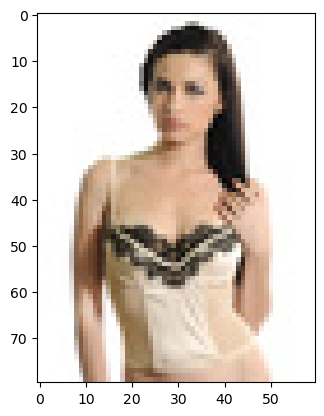

Bwitch Women Black Xtra Slim Shapewear


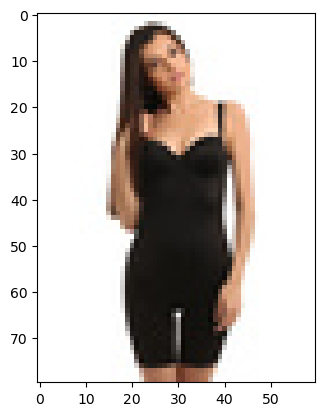

104
Turtle Check Men Navy Blue Shirt


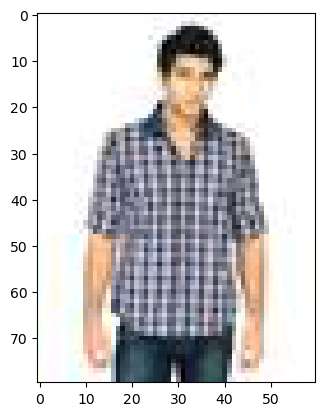

Fabindia Men Striped Green Shirt


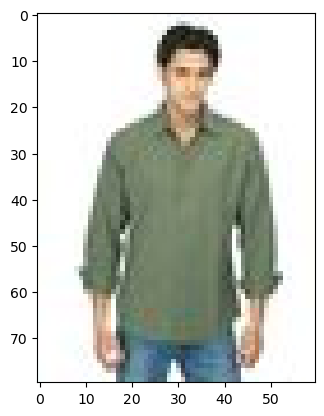

105
Timberland Unisex Rubber Sole Brush Shoe Accessories


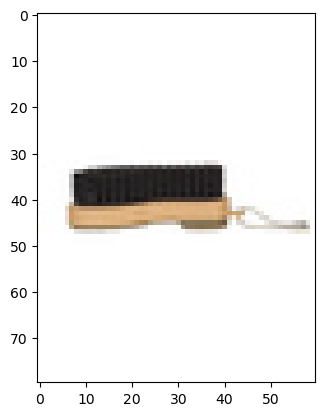

Timberland Unisex Boot Lace Shoe Accessories


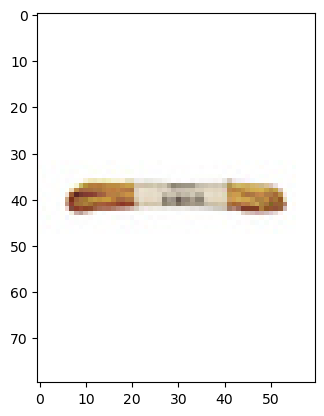

106
Timberland Unisex Hiker Round Lace Shoe Accessories


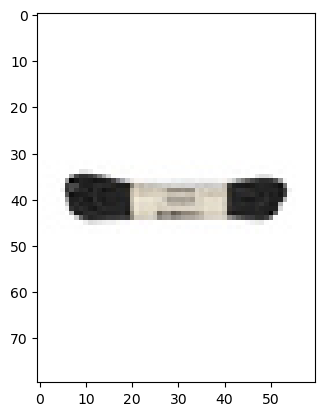

107
Puma Men Long Logo Black Bermuda


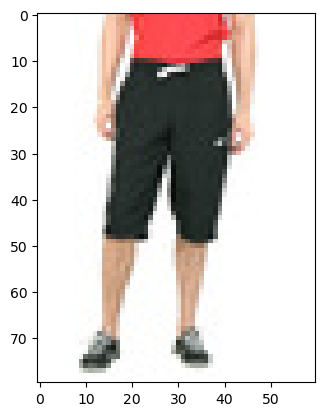

Do U Speak Green Men Blue Shorts


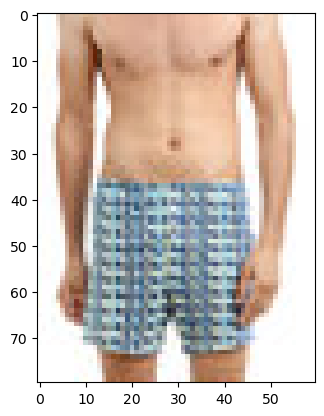

108
Tonga Women Pink Printed Shrug


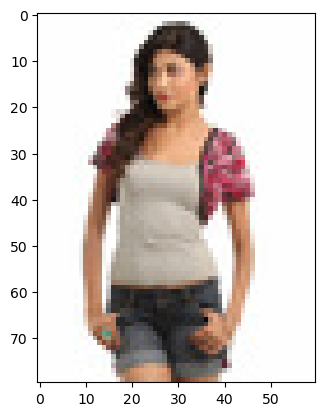

Tonga Women Coffee Brown Shrug


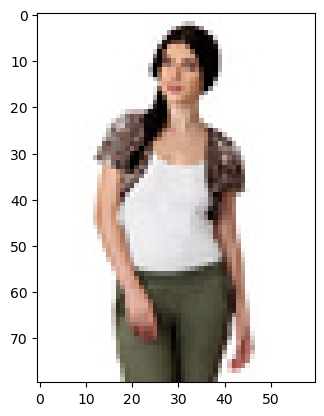

109
Urban Yoga Women Blue Skirt With Leggings


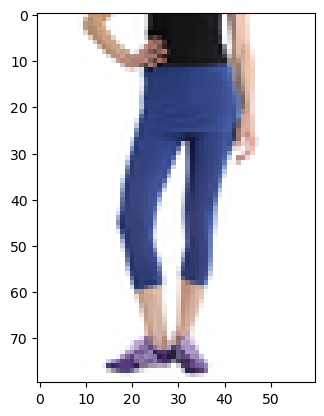

Mineral Women Grey Skirt


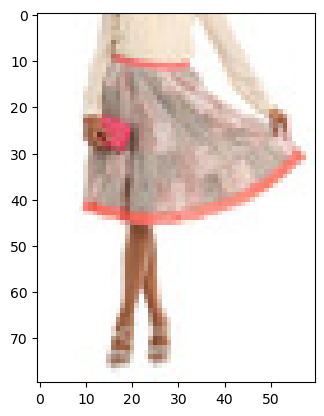

110
Puma Men Pack of 3 Socks


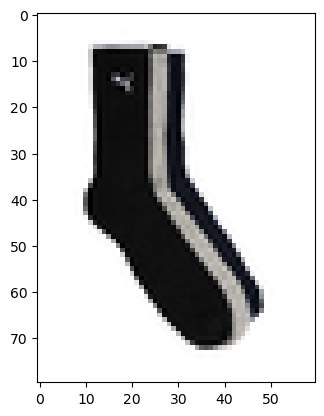

United Colors of Benetton Men Pack of 2 Grey Socks


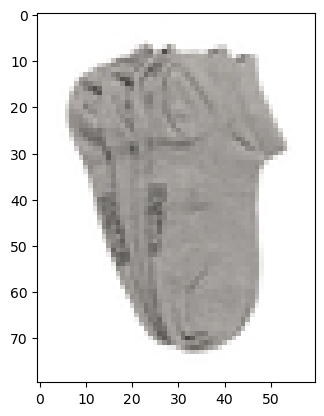

111
Reebok Men Navy Twist Sandals


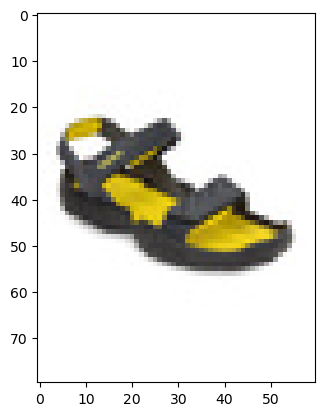

Puma Women Purple Techno Sandals


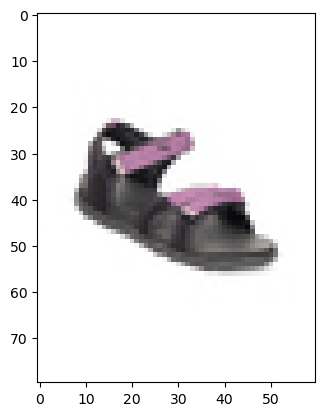

112
Nike Men's Incinerate MSL White Blue Shoe


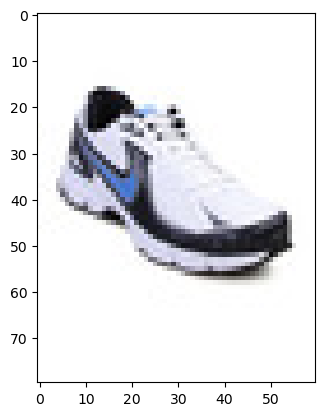

ADIDAS Men's Lowell White Silver Shoe


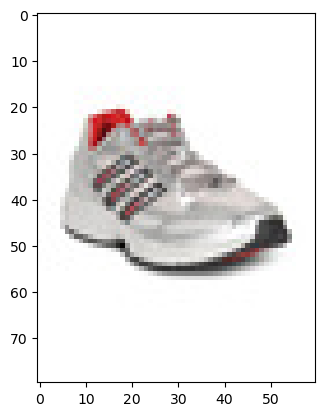

113
United Colors Of Benetton Women Black Tights


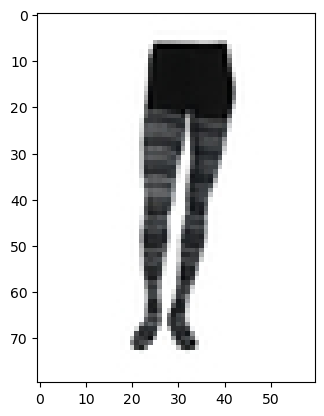

United Colors of Benetton Women Grey Striped Tights


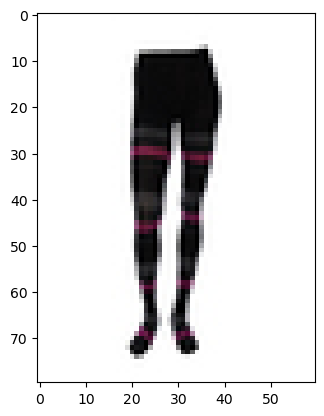

114
Fabindia Women Printed Beige & Black Stole


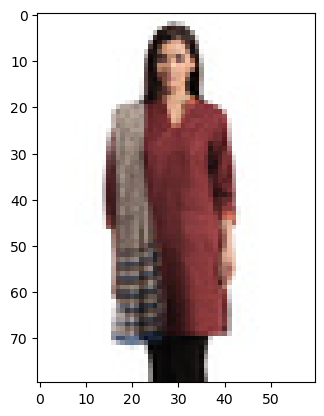

Fabindia Women Printed Beige & Black Stole


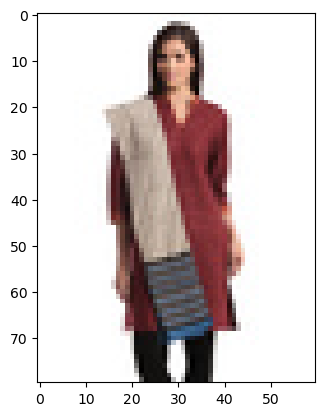

115
Image Men Sunglasses


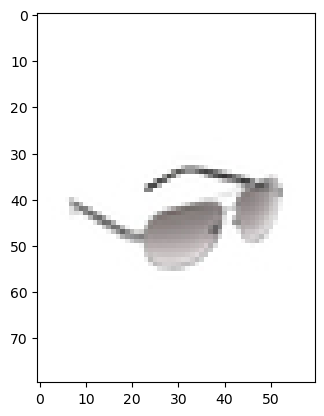

Ray-Ban Men Active Lifestyle Copper Sunglasses


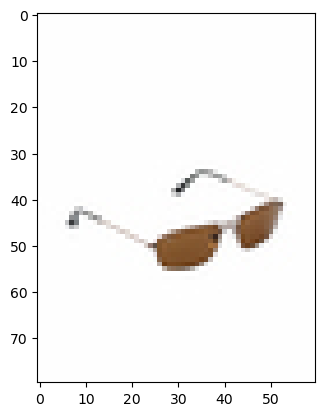

116
Lotus Herbals Kids Sun Block Cream


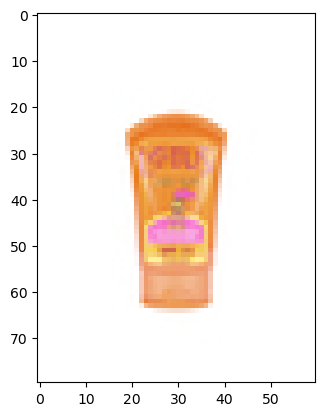

Lotus Herbals Safe Sun Sunscreen for Men


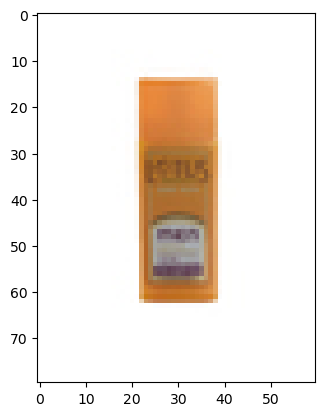

117
Arrow Men Light Brown Suspenders


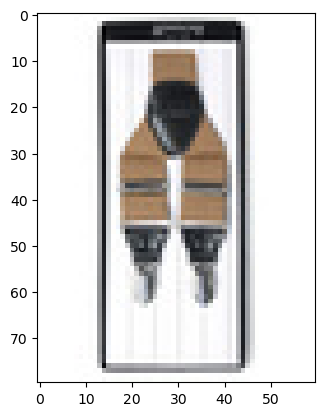

Lino Perros Men Black Suspenders


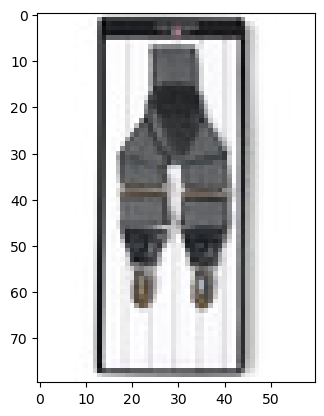

118
United Colors of Benetton Men Solid Blue Sweater


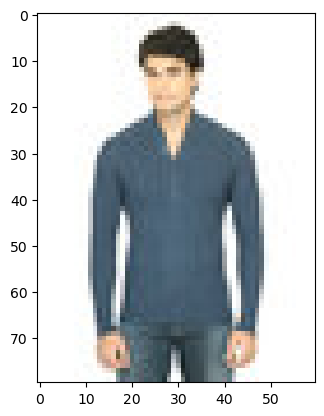

United Colors Of Benetton Men Heavy Winter Grey Sweaters


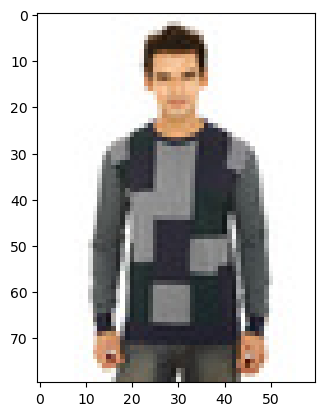

119
ADIDAS Men Lfc Auth Hood Grey Sweatshirts


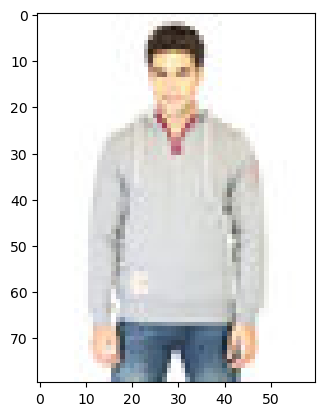

ADIDAS Men Blue Sweatshirt


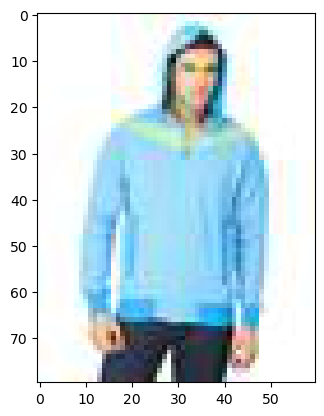

120
Nabaiji Swimming Goggles Blue Black


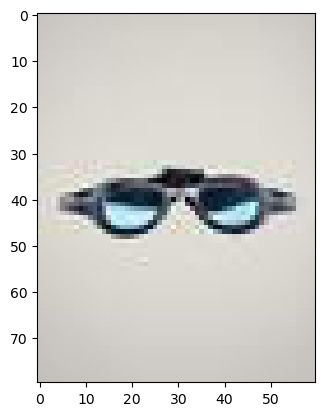

Nabaiji Women Solid Black Swimsuit


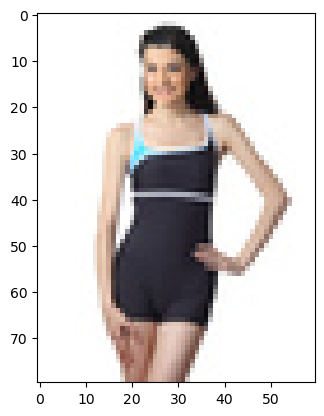

121
Tortoise Unisex Blue Tablet Sleeve


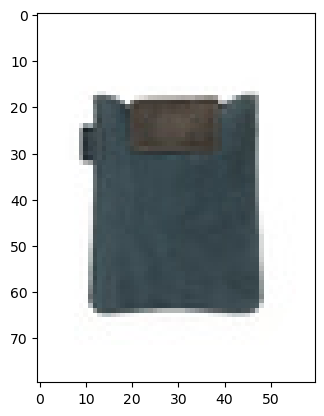

Baggit Women Black I-Pad Cover


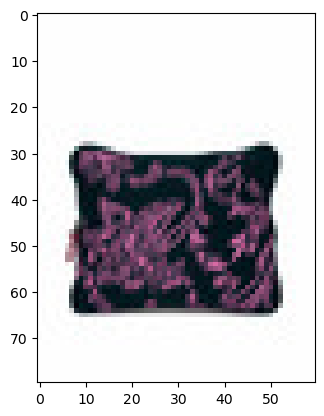

122
Turtle Men Stripes Burgundy Ties


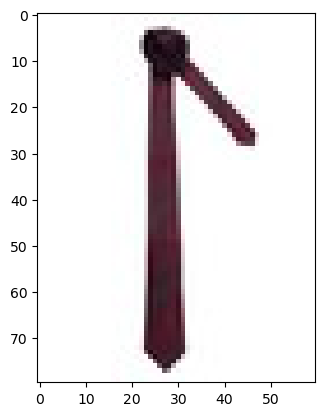

Park Avenue Blue Patterned Tie


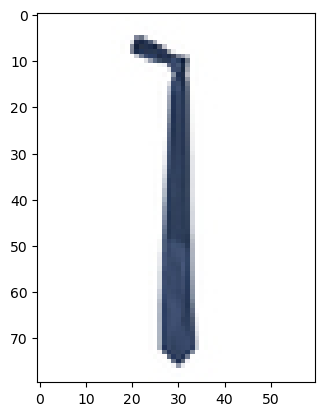

123
Miami Blues Women Sunglasses


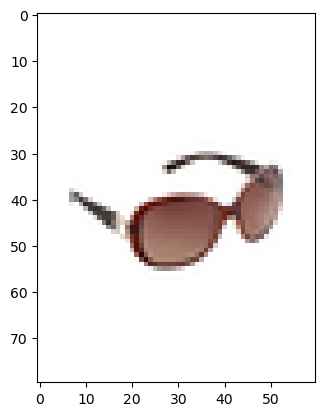

Polaroid Women Sunglasses


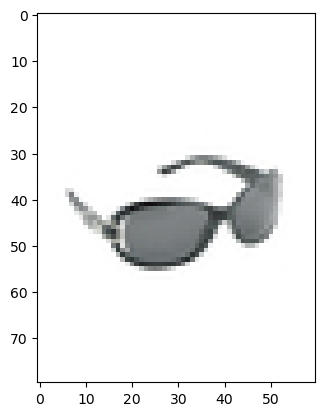

124
United Colors of Benetton Women Olive Floral Design Tights


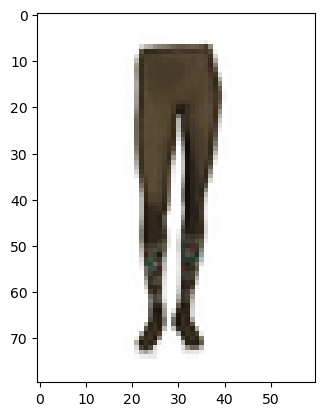

ADIDAS Women Purple Tights


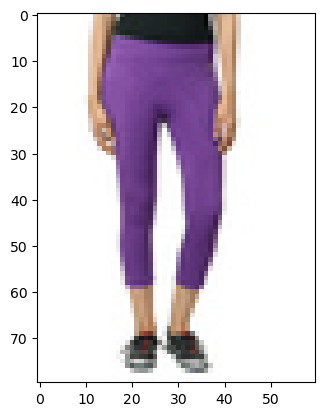

125
Lotus Herbals Rosetone Facial Skin Toner


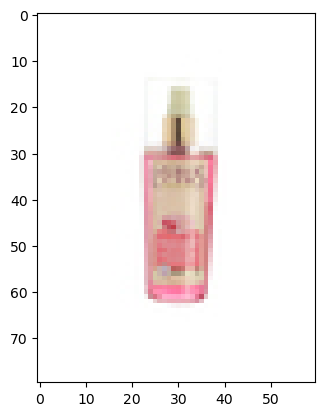

Revlon Age Defying Sculpt -Logic Re-shaping Toner


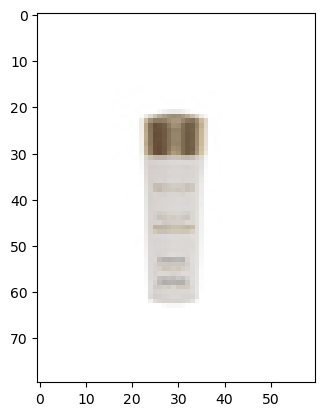

126
Gini and Jony Girls Knit White Top


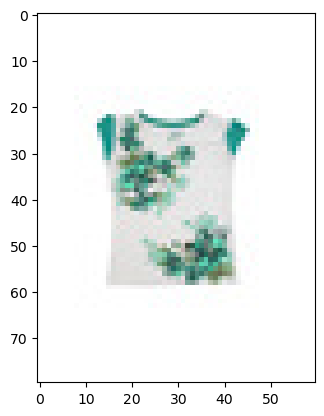

Mineral Women Green Top


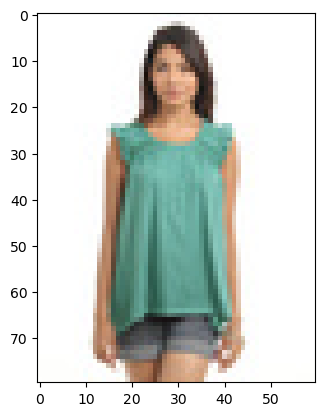

127
Manchester United Men Solid Black Track Pants


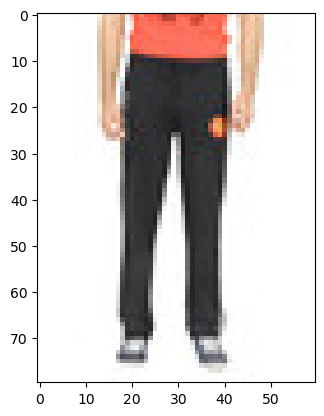

ADIDAS Men Solid Navy Blue Track Pant


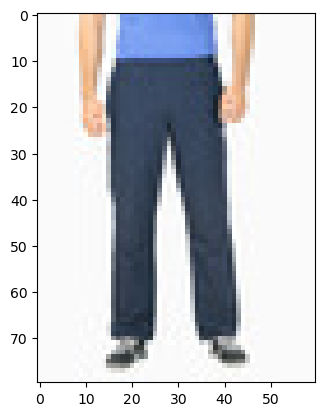

128
Puma Men Poly Knitted Black Tracksuit


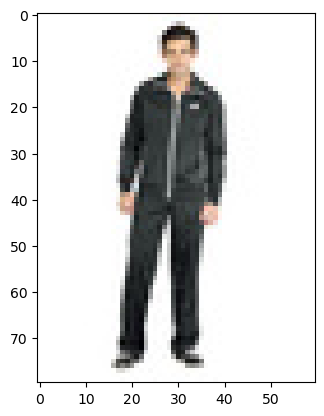

Proline Men Grey Tracksuit


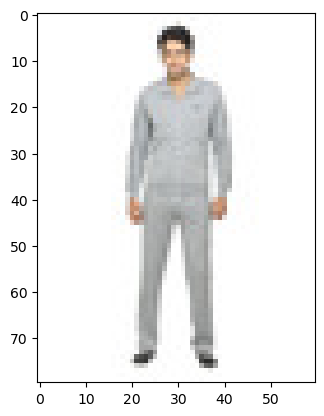

129
Wildcraft Unisex Rust Orange Travel Pouch


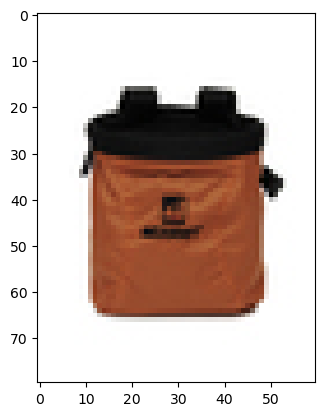

United Colors of Benetton Women Solid Blue Bags


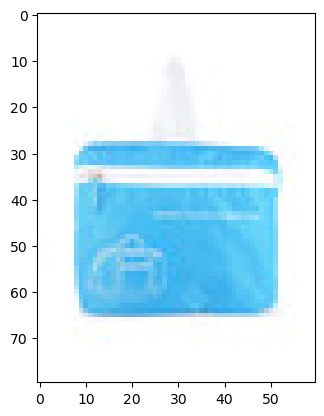

130
Peter England Unisex Black One Dayer Black Trolley Bag


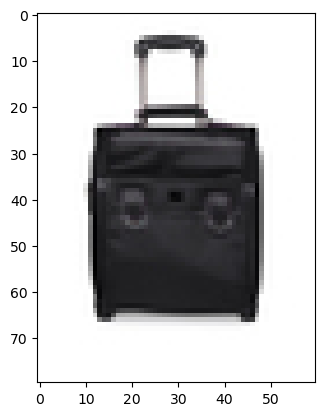

American Tourister Unisex Black Trolley Bag


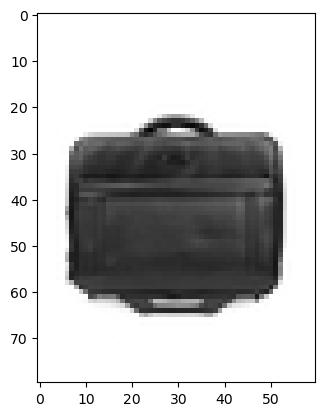

131
John Miller Men Solid Type Black Trousers


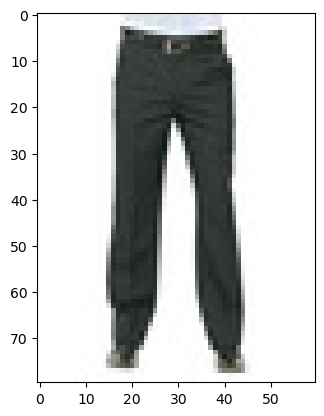

ONLY Women directoire blue Trousers


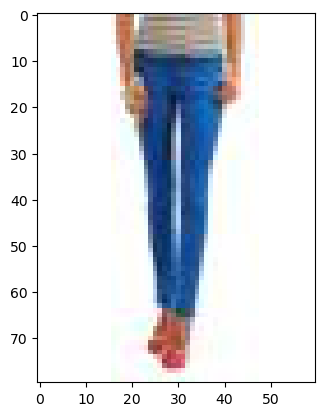

132
Chromozome Men Charcoal Trunk Trunks


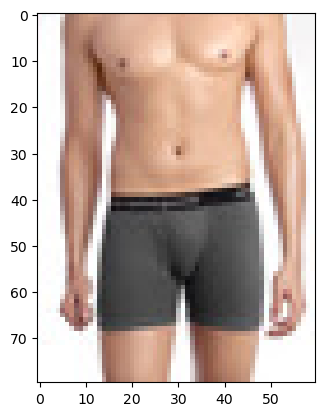

Chromozome Men Pack of Two Trunks


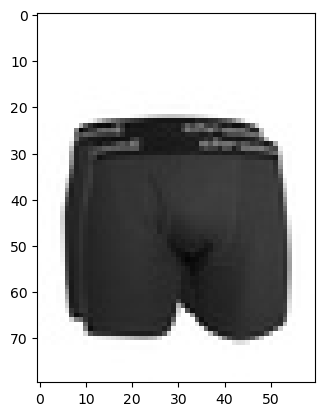

133
Puma Men Grey T-shirt


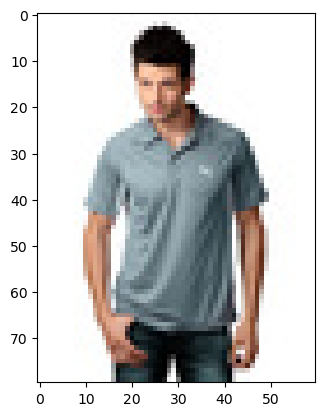

Inkfruit Mens Chain Reaction T-shirt


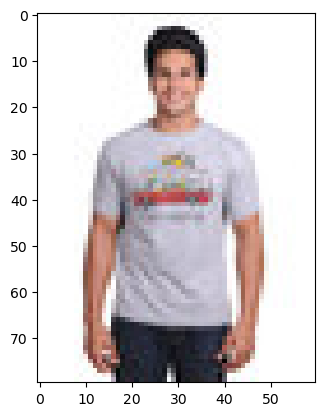

134
Fusion Beats Women White Printed Tunic


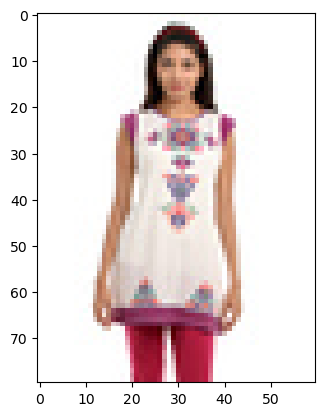

109F Women Red & White Striped Tunic


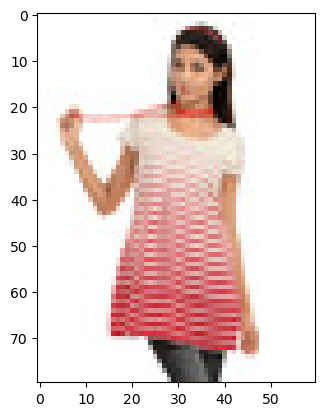

135
United Colors of Benetton Women Printed Purple Umbrellas


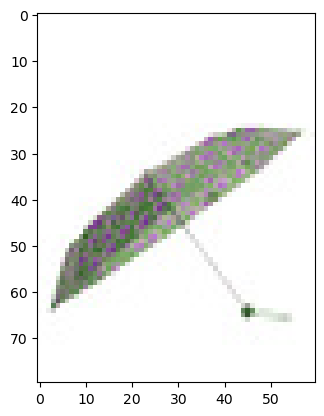

United Colors of Benetton Women Printed Blue Umbrellas


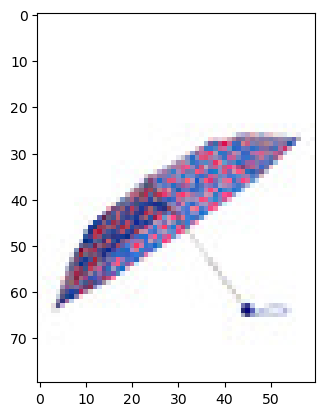

136
Wildcraft Unisex Gear for Life Black Waist Pouch


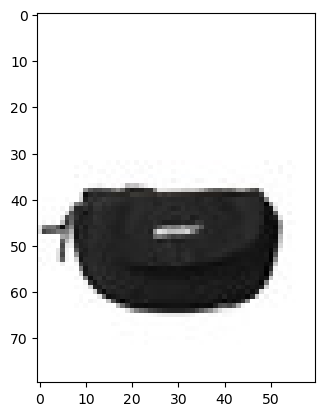

Wildcraft Unisex Grey & Yellow Waist Pouch


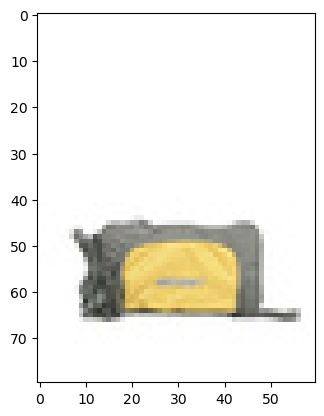

137
Scullers Men  Grey Waistcoat


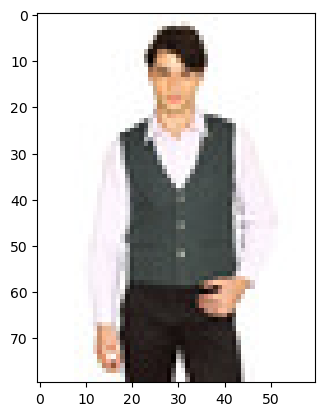

ONLY Women Blue Waistcoat


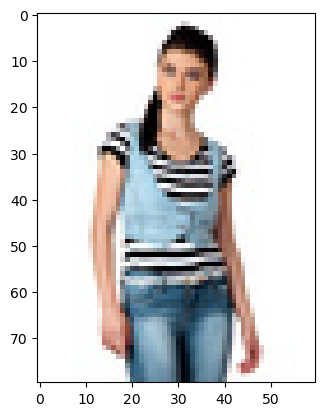

138
Arrow Men Black Wallet


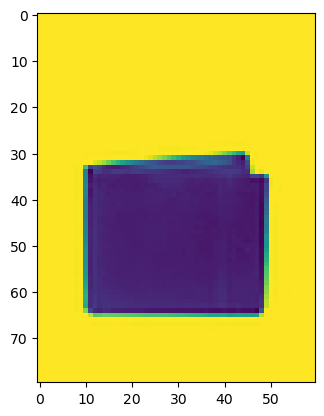

United Colors of Benetton Women Solid Beige Wallets


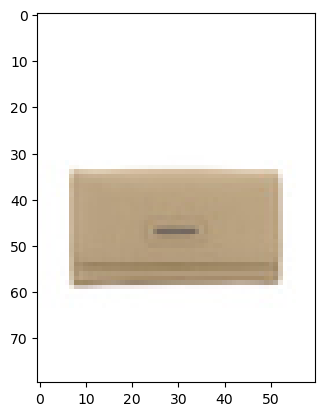

139
Titan Women Silver Watch


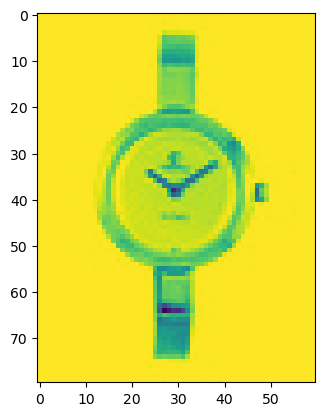

Skagen Men Black Watch


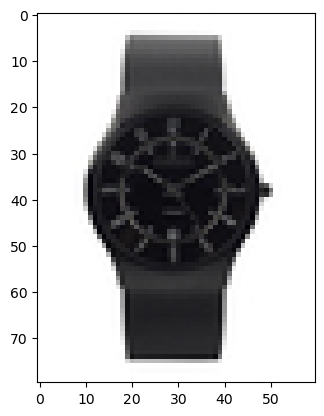

140
Quechua Aluminium Print Water Bottle


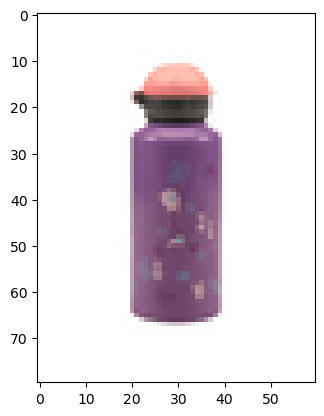

Quechua Easy-to-Carry Pink Sipper


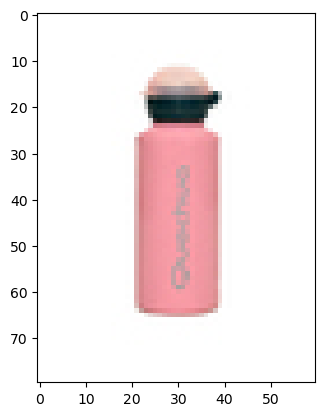

141
Puma Unisex Pack of 2 Red Wristband


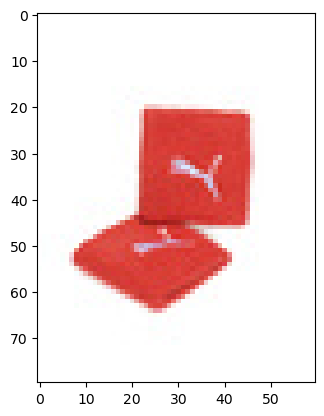

ADIDAS Unisex Nba Black Wristbands


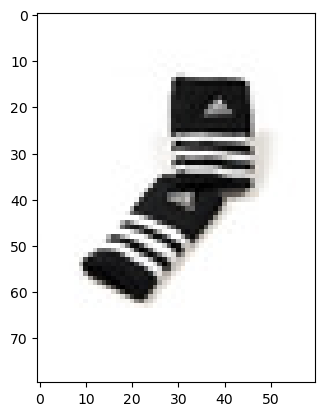

In [8]:
import matplotlib.pyplot as plt
from PIL import Image

group_count = 0
for group_name, group_df in labelGroup_df:
    print(group_name)
    img_count = 0
    for index, row in group_df.iterrows():
        print(row['productDisplayName'])
        image_path = f'C:/Users/John Justine/Downloads/archive (10)/e-commerce/images/{row["id"]}.jpg'
        pil_im = Image.open(image_path)
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
        img_count += 1
        if img_count == 2:
            break

        group_count += 1
        if group_count == 2:
            break

In [9]:
from sklearn.model_selection import train_test_split

y = data.pop('articleType_encoded')
X = data

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.4,random_state=0)

In [10]:
#Resnet architecture for CV
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
IMG_SIZE = 224
size = (IMG_SIZE,IMG_SIZE)
img_model = ResNet50(input_shape = (IMG_SIZE, IMG_SIZE, 3), include_top = False, weights = None)


In [11]:
import pandas as pd
import numpy as np
from PIL import Image
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import os
import nltk
import matplotlib.pyplot as plt
import torchvision.models as models
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch
from sklearn.model_selection import train_test_split
import torch.optim as optim
from transformers import BertTokenizer, BertModel

In [12]:
#Distil bert for text_embedding
from sentence_transformers import SentenceTransformer, util
model = SentenceTransformer('stsb-distilbert-base')
model.max_seq_length = 128


In [13]:
def get_textEmbeddings(model,text):
    text_embedding = model.encode(text, convert_to_tensor=True)
    return text_embedding

def get_imageEmbeddings(model,imagePath):
    image = tf.keras.preprocessing.image.load_img(imagePath,target_size= size)
    input_arr = tf.keras.preprocessing.image.img_to_array(image)
    input_arr = np.array([input_arr])
    img_embeddings = model(input_arr)
    meanImgEmb1 = np.mean(img_embeddings,axis =0)
    meanImgEmb2 = np.mean(meanImgEmb1,axis=0)
    meanImgEmb = np.mean(meanImgEmb2,axis=0)
    return meanImgEmb

In [56]:
print(np.shape(X_train)) 
#the train size is 26664 rows, took almost 2hrs for text embedding


(26664, 10)


In [15]:
str(row[9])

'ADIDAS Unisex Nba Black Wristbands'

In [22]:
import os
import time

text_embeddings = {}
image_embeddings = {}
start_time = time.time()
total_iterations = len(X_train)

# Image directory path
image_dir = r'C:\Users\John Justine\Downloads\archive (10)\e-commerce\images'

# Progress bar for text embeddings
print("Text Embeddings Progress:")
for index, row in enumerate(X_train.iterrows(), start=1):
    txt_emb = get_textEmbeddings(model, str(row[1][9]))
    text_embeddings[row[1][0]] = txt_emb

    # Print progress with serial number
    print(f"{index}. Processed {index} out of {total_iterations} rows for text embeddings.")

Text Embeddings Progress:
1. Processed 1 out of 26664 rows for text embeddings.
2. Processed 2 out of 26664 rows for text embeddings.
3. Processed 3 out of 26664 rows for text embeddings.
4. Processed 4 out of 26664 rows for text embeddings.
5. Processed 5 out of 26664 rows for text embeddings.
6. Processed 6 out of 26664 rows for text embeddings.
7. Processed 7 out of 26664 rows for text embeddings.
8. Processed 8 out of 26664 rows for text embeddings.
9. Processed 9 out of 26664 rows for text embeddings.
10. Processed 10 out of 26664 rows for text embeddings.
11. Processed 11 out of 26664 rows for text embeddings.
12. Processed 12 out of 26664 rows for text embeddings.
13. Processed 13 out of 26664 rows for text embeddings.
14. Processed 14 out of 26664 rows for text embeddings.
15. Processed 15 out of 26664 rows for text embeddings.
16. Processed 16 out of 26664 rows for text embeddings.
17. Processed 17 out of 26664 rows for text embeddings.
18. Processed 18 out of 26664 rows for t

In [23]:
# Progress bar for image embeddings
print("\nImage Embeddings Progress:")
for index, row in enumerate(X_train.iterrows(), start=1):
    image_id = row[1][0]
    image_path = os.path.join(image_dir, f"{image_id}.jpg")  # Construct full image path
    img_emb = get_imageEmbeddings(img_model, image_path)
    image_embeddings[row[1][0]] = img_emb

    # Print progress with serial number
    print(f"{index}. Processed {index} out of {total_iterations} rows for image embeddings.")

end_time = time.time()
print("\nTime taken:", end_time - start_time)



Image Embeddings Progress:
1. Processed 1 out of 26664 rows for image embeddings.
2. Processed 2 out of 26664 rows for image embeddings.
3. Processed 3 out of 26664 rows for image embeddings.
4. Processed 4 out of 26664 rows for image embeddings.
5. Processed 5 out of 26664 rows for image embeddings.
6. Processed 6 out of 26664 rows for image embeddings.
7. Processed 7 out of 26664 rows for image embeddings.
8. Processed 8 out of 26664 rows for image embeddings.
9. Processed 9 out of 26664 rows for image embeddings.
10. Processed 10 out of 26664 rows for image embeddings.
11. Processed 11 out of 26664 rows for image embeddings.
12. Processed 12 out of 26664 rows for image embeddings.
13. Processed 13 out of 26664 rows for image embeddings.
14. Processed 14 out of 26664 rows for image embeddings.
15. Processed 15 out of 26664 rows for image embeddings.
16. Processed 16 out of 26664 rows for image embeddings.
17. Processed 17 out of 26664 rows for image embeddings.
18. Processed 18 out 

In [26]:
image_embeddings

{45242: array([ 1.832596 ,  6.9171057,  1.6147147, ..., 15.600171 ,  4.218646 ,
         3.7588296], dtype=float32),
 42672: array([ 3.2143471,  8.538408 ,  0.9554491, ..., 21.812008 ,  5.3104873,
         4.4500575], dtype=float32),
 28890: array([ 2.871839  ,  6.038587  ,  0.43917927, ..., 16.915201  ,
         4.1516123 ,  3.2986128 ], dtype=float32),
 25709: array([ 3.292679 ,  7.8546634,  1.5458605, ..., 23.492231 ,  5.541111 ,
         4.604154 ], dtype=float32),
 22851: array([ 3.5110288,  7.998824 ,  1.4785845, ..., 23.064167 ,  5.268962 ,
         4.5661445], dtype=float32),
 17212: array([ 3.888508 ,  8.439917 ,  1.3148416, ..., 24.77898  ,  5.615666 ,
         4.81566  ], dtype=float32),
 7887: array([ 2.8194642,  8.172838 ,  1.3141031, ..., 20.999346 ,  4.979133 ,
         4.4153376], dtype=float32),
 16606: array([ 2.5297356,  7.7831793,  1.0808198, ..., 20.683502 ,  5.1704154,
         4.365604 ], dtype=float32),
 20565: array([ 2.9907315,  7.091717 ,  1.6499399, ..., 19.

In [27]:
text_embeddings

{45242: tensor([ 3.4603e-01,  8.0290e-02,  9.8248e-01, -5.1147e-02,  6.6512e-01,
          4.5955e-01, -2.5188e-01,  1.5758e-01, -4.0499e-01, -5.0960e-01,
          1.6682e-01,  4.4089e-01, -6.3961e-01,  4.3085e-01, -4.3111e-01,
         -5.5001e-01,  9.0229e-01, -2.0235e-02,  2.8266e-01, -1.3322e-01,
          1.2359e+00,  3.2791e-01,  5.5588e-01,  4.2679e-01, -4.2370e-01,
         -7.4656e-02,  3.1730e-01,  7.3712e-01,  2.2407e-01, -2.2337e-02,
          3.3393e-01, -9.3385e-01, -5.5922e-01,  1.0973e+00,  4.2389e-01,
          4.0230e-01, -3.4011e-01,  5.9729e-01,  7.0026e-01,  1.6799e-01,
         -6.1636e-02, -5.5117e-01,  5.0583e-02,  3.0300e-02, -1.1818e-02,
          6.9985e-01, -7.0011e-01, -3.1202e-01,  2.6536e-01,  3.5606e-01,
         -1.1232e-01,  1.9792e-01,  7.6979e-01, -1.4291e-01,  7.1642e-01,
         -1.0859e-01,  5.0001e-01, -2.1118e-01,  5.5572e-01, -9.8052e-02,
          2.3446e-01,  1.7237e-01,  1.5534e-01, -3.0249e-01, -3.4597e-03,
         -5.5305e-01, -3.1857e-

In [28]:
import pickle
with open('./textEmb','wb') as handle:
    pickle.dump(text_embeddings,handle)
with open('./imgEmb','wb') as handle:
    pickle.dump(image_embeddings,handle)

In [39]:
keyList=[]
cembList=[]
imageList=[]
titleList=[]
for index, row in X_train.iterrows():
    #start_time=time.time()
    txt_emb = text_embeddings[row[0]]
    print(np.shape(txt_emb))
    img_emb = image_embeddings[row[0]] 
    print(np.shape(img_emb))
    cmb_emb = np.concatenate((txt_emb,img_emb),axis=0)
    print(np.shape(cmb_emb))
    norm = np.linalg.norm(cmb_emb)
    cmb_emb_normal = cmb_emb/norm
    keyList.append(row[0])
    cembList.append(cmb_emb_normal)
    imageList.append(row[0])
    titleList.append(row[9])

torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([768])
(2048,)
(2816,)
torch.Size([76

In [40]:
from sklearn.neighbors import NearestNeighbors
kneigh = NearestNeighbors(n_neighbors=5,leaf_size=5000,algorithm='kd_tree')
kneigh.fit(cembList)

NearestNeighbors(algorithm='kd_tree', leaf_size=5000)

In [41]:
def getNeighbours(query_emb):
    posting_id_list=[]
    neigh_dist,neigh_ind = kneigh.kneighbors(X=query_emb.reshape(1,-1), n_neighbors=5, return_distance=True)
    for ind in neigh_ind:
        #print(str(ind))
        for ind1 in ind:
            posting_id_list.append(str(ind1))
    return posting_id_list

In [42]:
postingidList=[]
matchesList=[]
index =0
for val in keyList:
    query_emb = cembList[index]
    postingid_list = getNeighbours(query_emb)
    postingidList.append(val)
    matchesList.append(" ".join(postingid_list))
    index =index +1 
    if index==100:
        break

In [43]:
print(titleList[:5])

['CASIO Baby-G Women Analogue & Digital Watch BX007', 'Alma Women Red Printed Kurta', 'Enamor Women Dark Pink Regular-Rise Bikini Brief', 'ADIDAS Unisex Red Cap', 'Woodland Men Khaki Casual Shoes']


##### Results
First we look at the original image and display matching images after '======='.

Train Data

CASIO Baby-G Women Analogue & Digital Watch BX007
45242


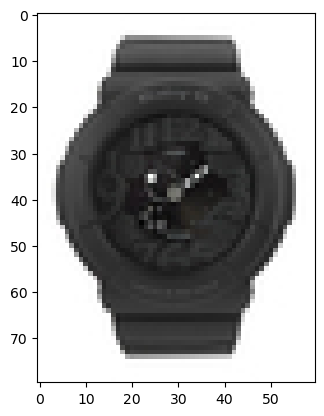

CASIO Baby-G Women Analogue & Digital Watch BX007
45242


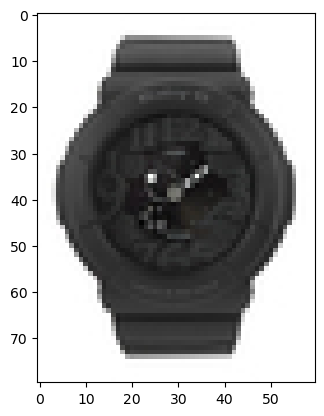

Fastrack Unisex Black Dial Watch 9915PP13
22950


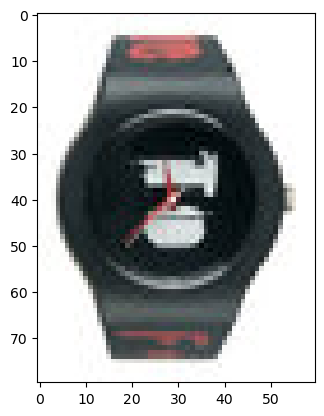

CASIO G-Shock Men Black Digital Watch G329
37318


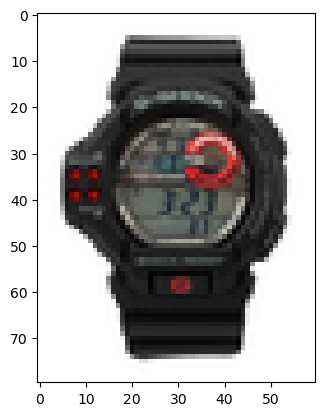

CASIO Baby-G Women Black Dial Analogue & Digital Watch BX004
45239


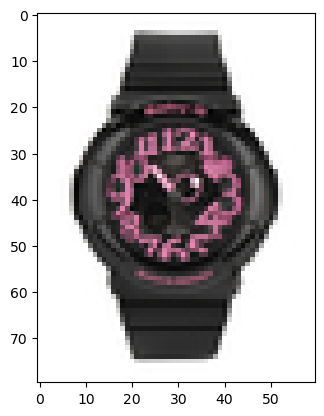

ADIDAS Originals Unisex Black Dial Watch ADH2580
16771


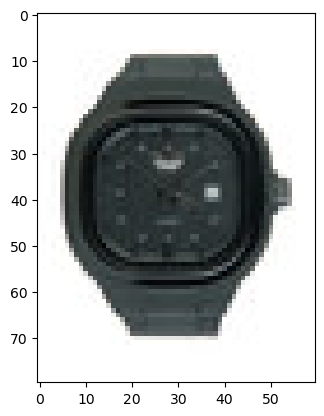

Alma Women Red Printed Kurta
42672


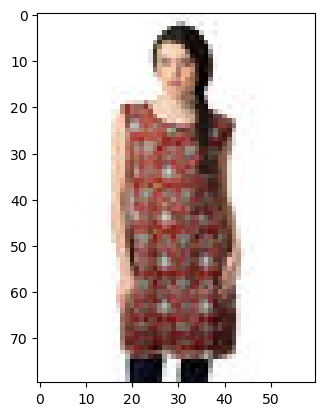

Alma Women Red Printed Kurta
42672


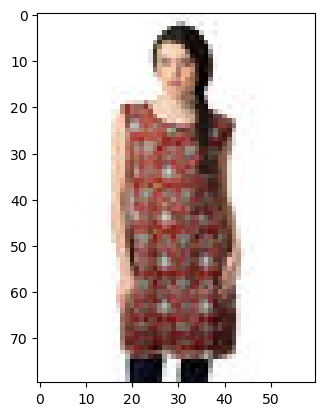

BIBA Women Printed Red Kurta
22746


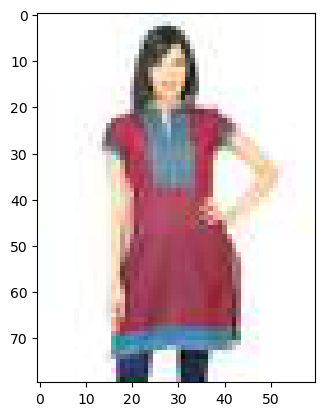

BIBA Women Printed Red Kurta
22763


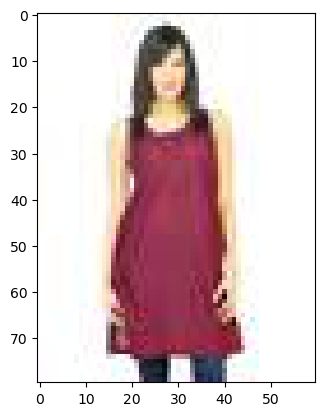

Alma Women Red Printed Kurta
42650


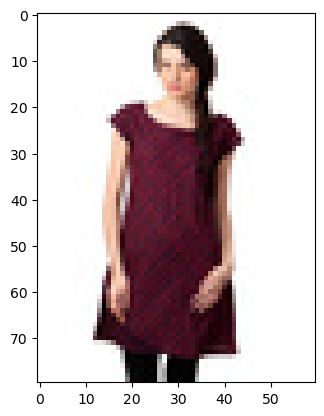

Alma Women Black Printed Kurta
53431


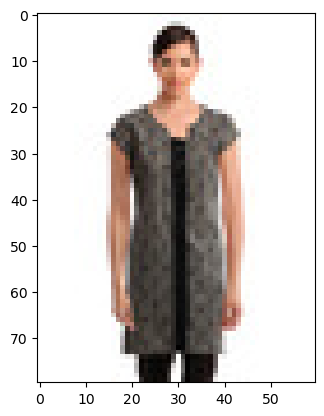

Enamor Women Dark Pink Regular-Rise Bikini Brief
28890


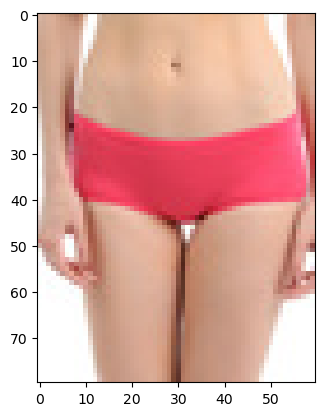

Enamor Women Dark Pink Regular-Rise Bikini Brief
28890


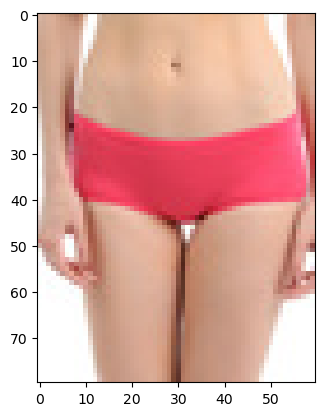

Enamor Women Light Brown Low-Rise Bikini Brief
28886


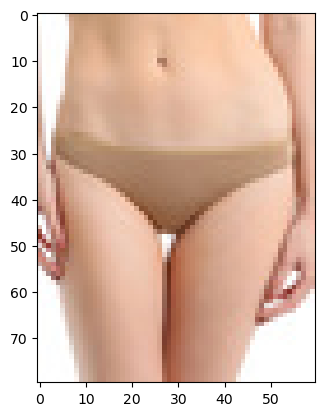

Enamor Women Red Low-Rise Bikini Brief
28902


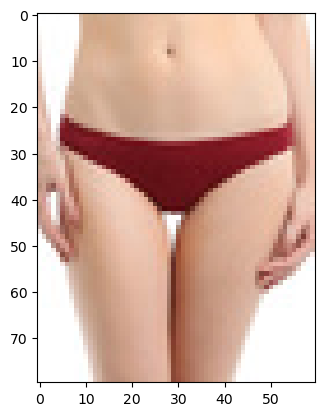

Enamor Women Purple Mid-Rise Bikini Brief
28897


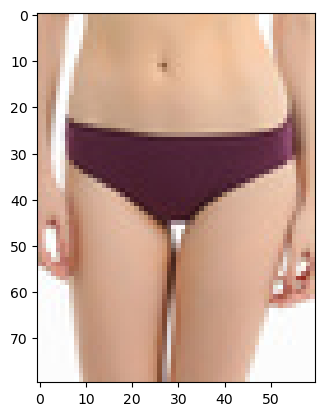

Enamor Women Cameo Rose Coloured Briefs
50984


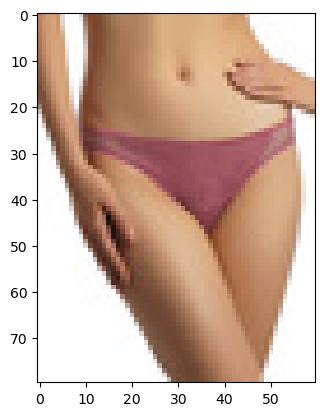

ADIDAS Unisex Red Cap
25709


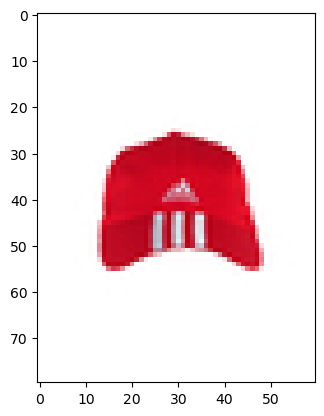

ADIDAS Unisex Red Cap
25709


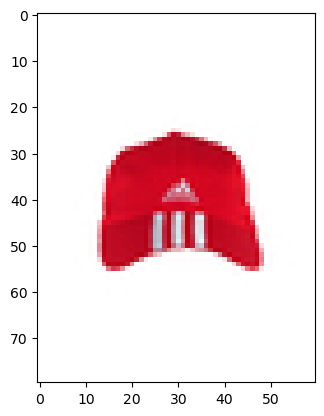

ADIDAS Originals Unisex Dicolor Red Cap
19886


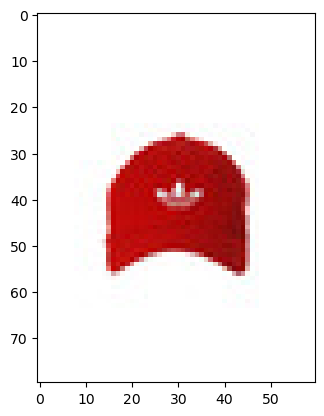

ADIDAS Unisex Pink Cap
25711


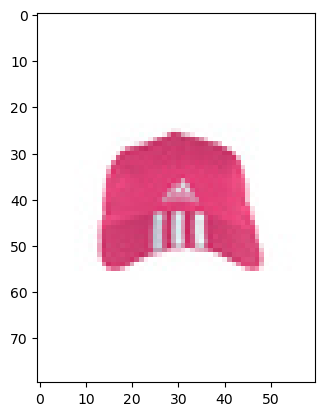

ADIDAS Unisex Black Cap
25708


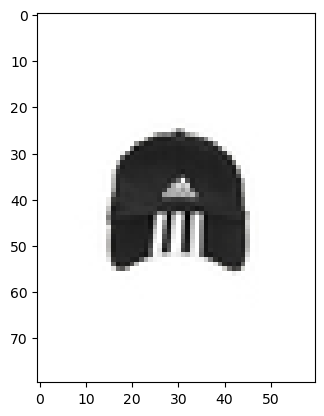

ADIDAS Unisex Black Cap
40112


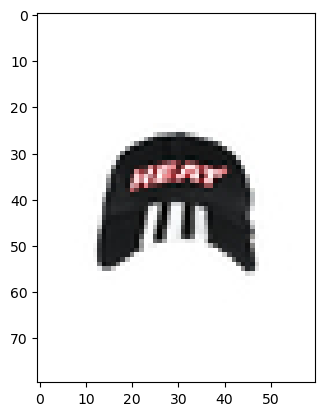

Woodland Men Khaki Casual Shoes
22851


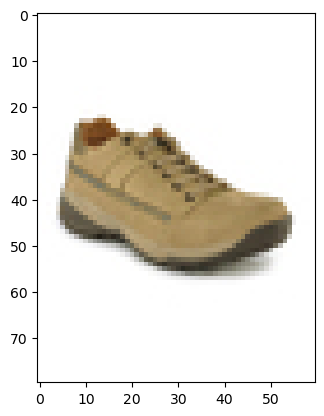

Woodland Men Khaki Casual Shoes
22851


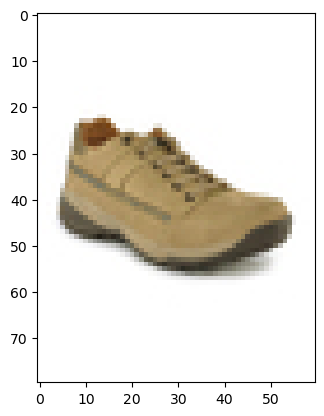

Woodland Men Khaki Casual Shoes
22842


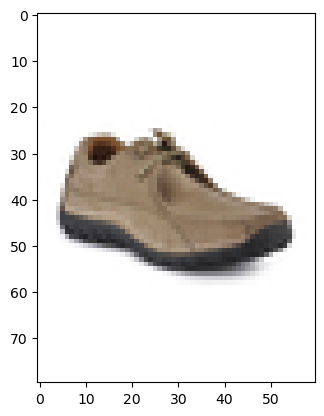

Woodland Men Khaki Casual Shoes
22831


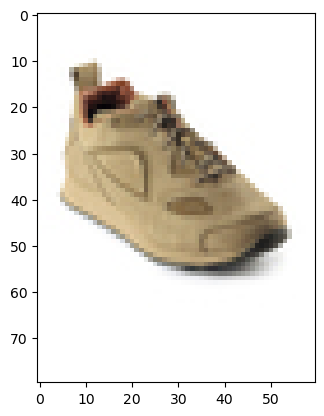

Woodland Men Khaki Casual Shoes
22859


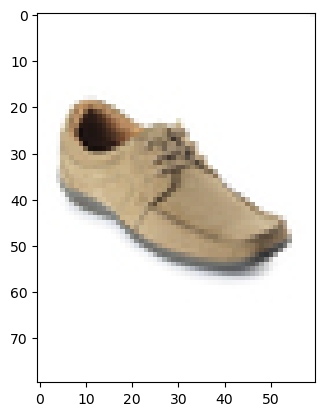

Woodland Men Khaki Casual Shoes
22865


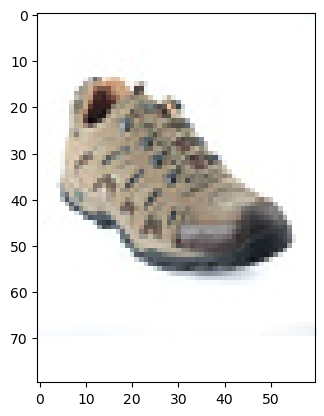

United Colors of Benetton Men Funky Eyewear Black Sunglasses
17212


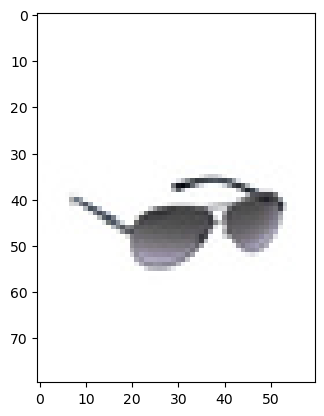

United Colors of Benetton Men Funky Eyewear Black Sunglasses
17212


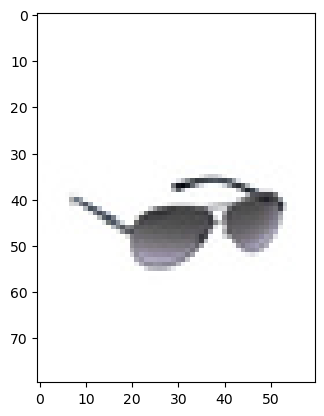

United Colors of Benetton Men Funky Eyewear Black Sunglasses
17206


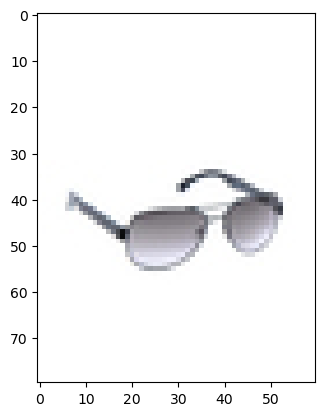

United Colors of Benetton Men Funky Eyewear Black Sunglasses
17217


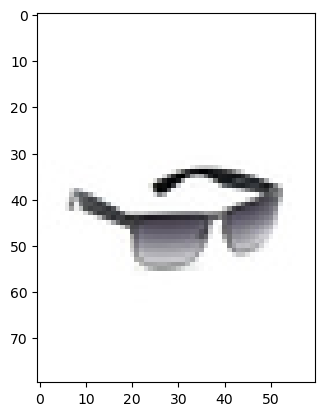

United Colors of Benetton Men Funky Eyewear Black Sunglasses
17220


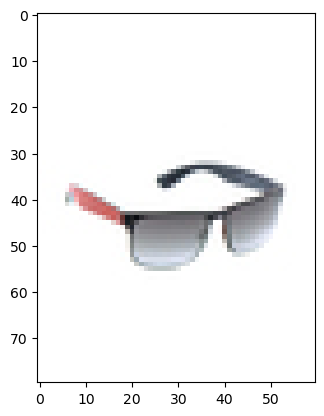

United Colors of Benetton Men Black Sunglasses
48227


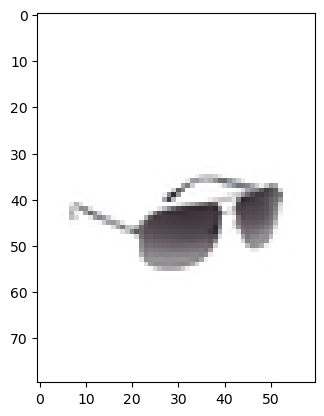

Proline Men Blue Track Pants
7887


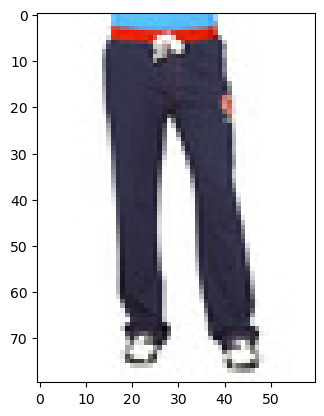

Proline Men Blue Track Pants
7887


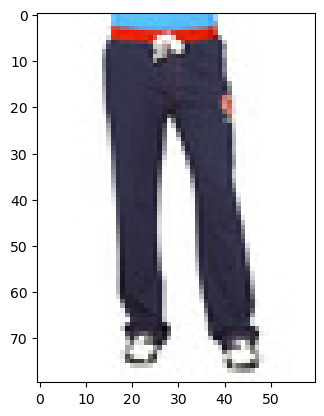

Proline Men Black Track Pants
7884


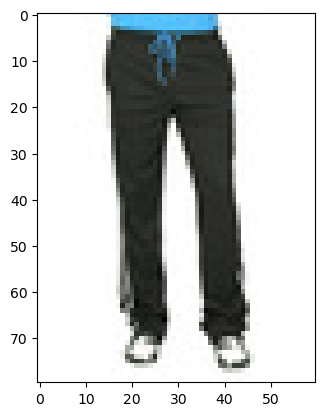

Proline Men Navy Blue Track Pants
34255


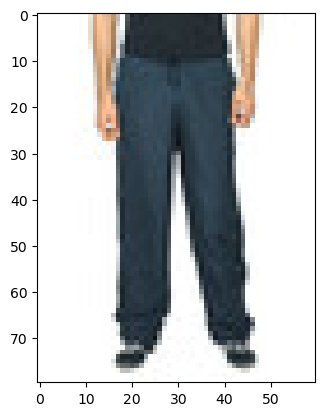

Proline Men  Navy Blue Track Pants
26320


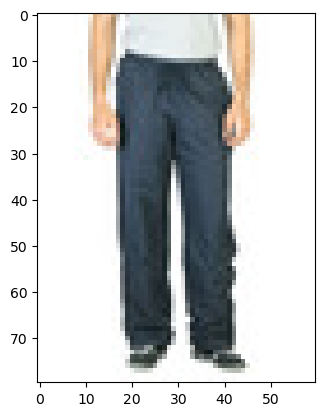

Proline Men Navy Track Pants
26259


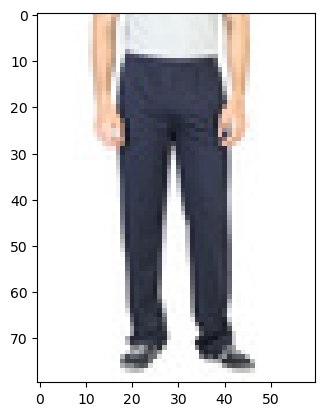

Jealous 21 Women Solid Purple Knit Top
16606


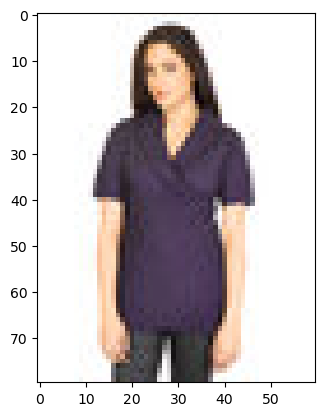

Jealous 21 Women Solid Purple Knit Top
16606


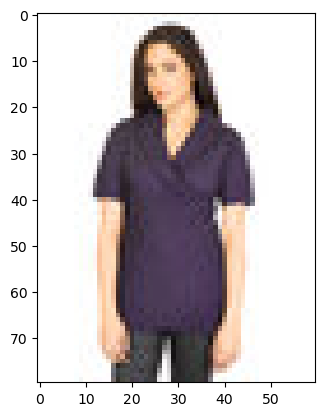

Jealous 21 Women Knit Purple Top
4621


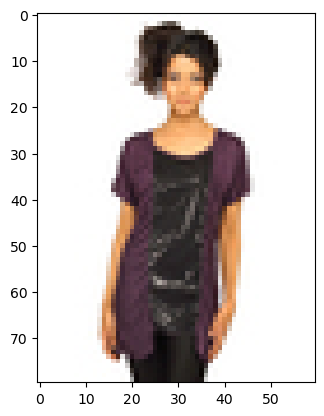

Jealous 21 Women Casual Top Purple Tops
14720


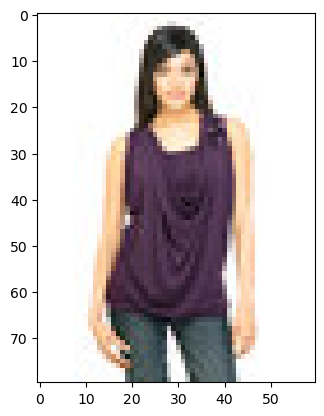

Jealous 21 Women Purple Shirt
26960


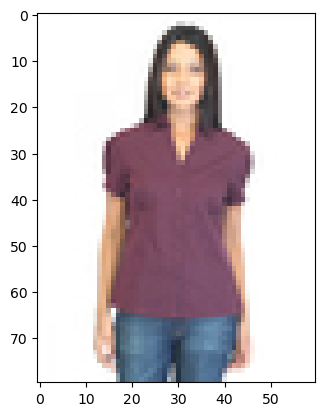

Jealous 21 Women Edie Purple Top
8435


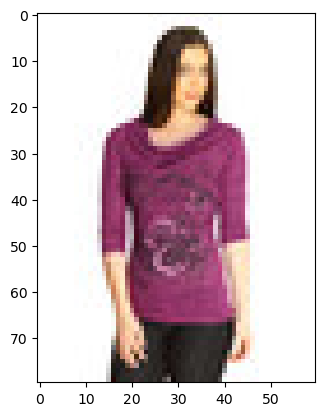

Baggit Women Turnoff Taj Purple Wallet
20565


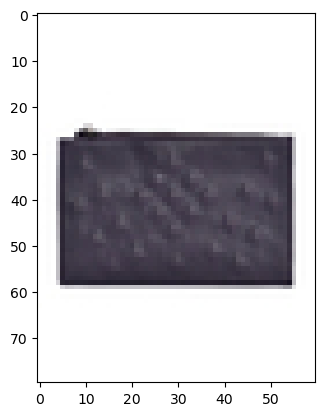

Baggit Women Turnoff Taj Purple Wallet
20565


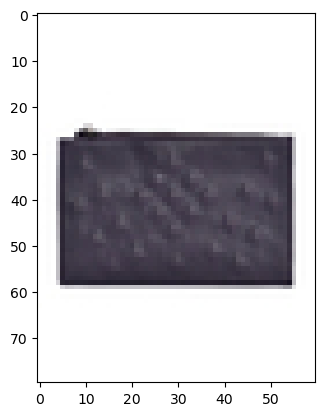

Baggit Women Turnoff Taj Green Wallet
20563


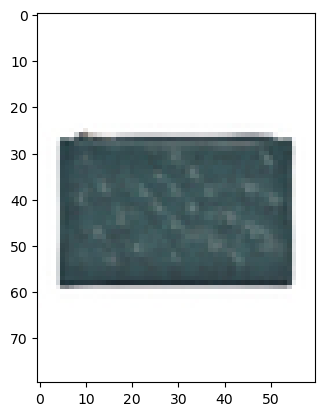

Baggit Women Famous Taj Purple Wallet
20464


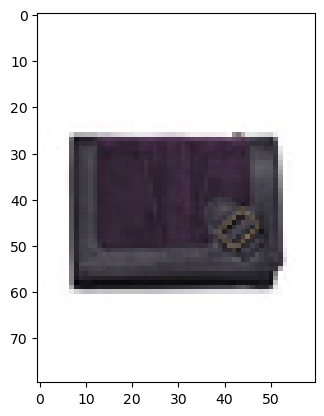

Baggit Women Tijori Taj Purple Wallet
20533


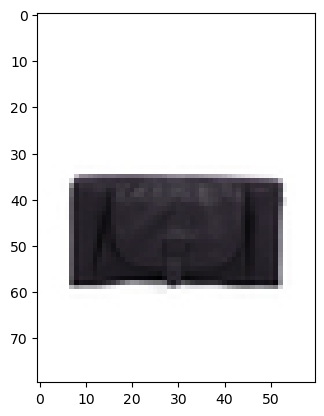

Baggit Women Highway Taj Purple Wallet
20586


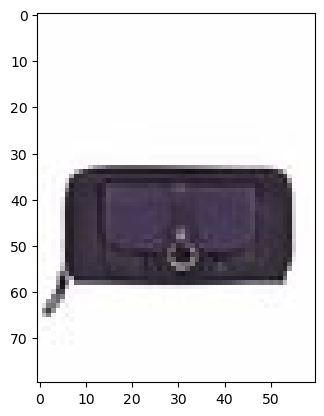

Ed Hardy Men Printed Peach Tshirts
12616


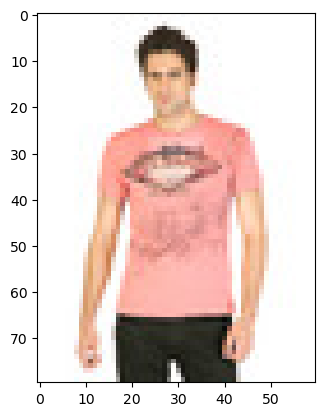

Ed Hardy Men Printed Peach Tshirts
12616


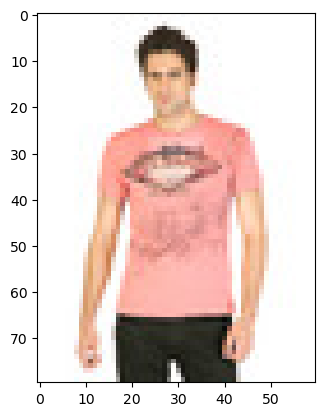

Ed Hardy Men Printed Orange Tshirts
12612


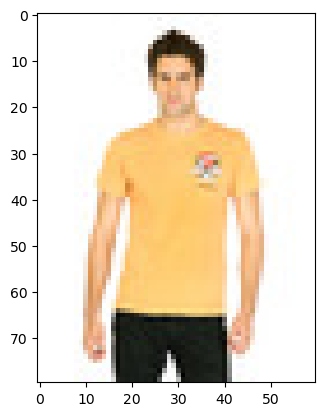

Mr.Men Little Miss Men Printed Fushia Pink Tshirt
20330


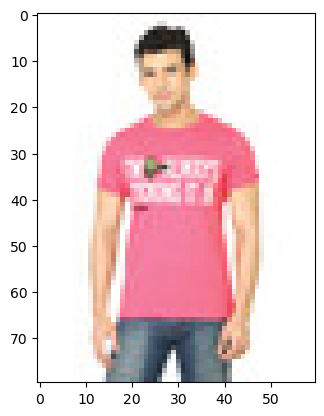

Ed Hardy Men Diving Dragon Peach T-Shirt
22368


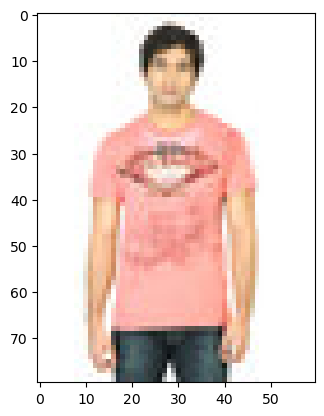

Lee Men Printed White Tshirts
11766


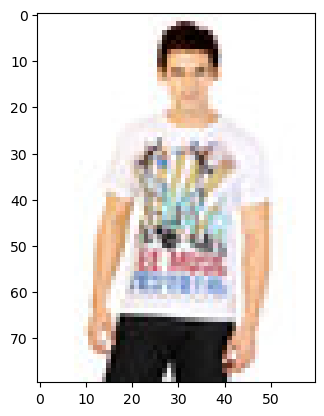

In [57]:
%matplotlib inline
index =0
for item in postingidList:
    print(titleList[index])
    print(keyList[index])
    imagePath = 'C:/Users/John Justine/Downloads/archive (10)/e-commerce/images/' + str(imageList[index]) + '.jpg'
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = matchesList[index].split(' ')
    print('================================================================================================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        print(keyList[int(ind)])
        imagePath = 'C:/Users/John Justine/Downloads/archive (10)/e-commerce/images/'+ str(imageList[int(ind)])+ '.jpg'
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
    if index == 10:
        break

testData

In [54]:
X_test.shape

(17777, 10)

# Since iterating through this will take more than 2 hrs i will not be able to find the validity of the model on test data

In [53]:
testkeyList=[]
testcembList=[]
testimageList=[]
testtitleList=[]
for index, row in X_test.iterrows():
    #start_time=time.time()
    txt_emb = get_textEmbeddings(model,str(row[3]))
    imagePath = 'C:/Users/John Justine/Downloads/archive (10)/e-commerce/images/'+str(row[0])+'.jpg'
    img_emb = get_imageEmbeddings(img_model,imagePath)
    text_embeddings[row[0]] = txt_emb
    image_embeddings[row[0]] = img_emb
    cmb_emb = np.concatenate((txt_emb,img_emb),axis=0)
    norm = np.linalg.norm(cmb_emb)
    cmb_emb_normal = cmb_emb/norm
    testkeyList.append(row[0])
    testcembList.append(cmb_emb_normal)
    testimageList.append(row[1])
    testtitleList.append(row[9])

KeyboardInterrupt: 

In [ ]:
%matplotlib inline
index =10
while index <20:
    print(testtitleList[index])
    print(testkeyList[index])
    imagePath = 'C:/Users/John Justine/Downloads/shopee-product-matching/train_images/'+ testimageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = testmatchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        print(keyList[int(ind)])
        imagePath = 'C:/Users/John Justine/Downloads/shopee-product-matching/train_images/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
   